<h1>ACDC Main Demo</h1>

<p>This notebook (which doubles as a script) shows several use cases of ACDC</p>

<p>The codebase is built on top of https://github.com/neelnanda-io/TransformerLens (source version)</p>

<h3>Setup:</h3>
<p>Janky code to do different setup when run in a Colab notebook vs VSCode (adapted from e.g <a href="https://github.com/neelnanda-io/TransformerLens/blob/5c89b7583e73ce96db5e46ef86a14b15f303dde6/demos/Activation_Patching_in_TL_Demo.ipynb">this notebook</a>)</p>

In [1]:
try:
    import google.colab

    IN_COLAB = True
    print("Running as a Colab notebook")

    import subprocess # to install graphviz dependencies
    command = ['apt-get', 'install', 'graphviz-dev']
    subprocess.run(command, check=True)

    import os # make images folder
    os.mkdir("ims/")

    from IPython import get_ipython
    ipython = get_ipython()

    ipython.run_line_magic( # install ACDC
        "pip",
        "install git+https://github.com/ArthurConmy/Automatic-Circuit-Discovery.git@d89f7fa9cbd095202f3940c889cb7c6bf5a9b516",
    )

except Exception as e:
    IN_COLAB = False
    print("Running outside of colab")

    import numpy # crucial to not get cursed error
    import plotly

    plotly.io.renderers.default = "colab"  # added by Arthur so running as a .py notebook with #%% generates .ipynb notebooks that display in colab
    # disable this option when developing rather than generating notebook outputs

    import os # make images folder
    if not os.path.exists("ims/"):
        os.mkdir("ims/")

    from IPython import get_ipython

    ipython = get_ipython()
    if ipython is not None:
        print("Running as a notebook")
        ipython.run_line_magic("load_ext", "autoreload")  # type: ignore
        ipython.run_line_magic("autoreload", "2")  # type: ignore
    else:
        print("Running as a script")

Running outside of colab
Running as a notebook


<h2>Imports etc</h2>

In [2]:
import wandb
import IPython
from IPython.display import Image, display
import torch
import gc
from tqdm import tqdm
import networkx as nx
import os
import torch
import huggingface_hub
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import einops
from tqdm import tqdm
import yaml
from transformers import AutoModelForCausalLM, AutoConfig, AutoTokenizer

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from transformer_lens.hook_points import HookedRootModule, HookPoint
from transformer_lens.HookedTransformer import (
    HookedTransformer,
)
try:
    from acdc.tracr_task.utils import (
        get_all_tracr_things,
        get_tracr_model_input_and_tl_model,
    )
except Exception as e:
    print(f"Could not import `tracr` because {e}; the rest of the file should work but you cannot use the tracr tasks")
from acdc.docstring.utils import get_all_docstring_things
from acdc.acdc_utils import (
    make_nd_dict,
    reset_network,
    shuffle_tensor,
    cleanup,
    ct,
    TorchIndex,
    Edge,
    EdgeType,
)  # these introduce several important classes !!!

from acdc.TLACDCCorrespondence import TLACDCCorrespondence
from acdc.TLACDCInterpNode import TLACDCInterpNode
from acdc.TLACDCExperiment import TLACDCExperiment

from acdc.acdc_utils import (
    kl_divergence,
)
from acdc.ioi.utils import (
    get_all_ioi_things,
    get_gpt2_small,
)
from acdc.induction.utils import (
    get_all_induction_things,
    get_validation_data,
    get_good_induction_candidates,
    get_mask_repeat_candidates,
)
from acdc.greaterthan.utils import get_all_greaterthan_things
from acdc.acdc_graphics import (
    build_colorscheme,
    show,
)
import argparse

torch.autograd.set_grad_enabled(False)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


<h2>ACDC Experiment Setup</h2>
<p>We use a `parser to set all the options for the ACDC experiment.
This is still usable in notebooks! We can pass a string to the parser, see below.
We'll reproduce </p>

In [11]:
parser = argparse.ArgumentParser(description="Used to launch ACDC runs. Only task and threshold are required")

task_choices = ['ioi', 'docstring', 'induction', 'tracr-reverse', 'tracr-proportion', 'greaterthan']
parser.add_argument('--task', type=str, required=True, choices=task_choices, help=f'Choose a task from the available options: {task_choices}')
parser.add_argument('--threshold', type=float, required=True, help='Value for THRESHOLD')
parser.add_argument('--first-cache-cpu', type=str, required=False, default="True", help='Value for FIRST_CACHE_CPU (the old name for the `online_cache`)')
parser.add_argument('--second-cache-cpu', type=str, required=False, default="True", help='Value for SECOND_CACHE_CPU (the old name for the `corrupted_cache`)')
parser.add_argument('--zero-ablation', action='store_true', help='Use zero ablation')
parser.add_argument('--using-wandb', action='store_true', help='Use wandb')
parser.add_argument('--wandb-entity-name', type=str, required=False, default="remix_school-of-rock", help='Value for WANDB_ENTITY_NAME')
parser.add_argument('--wandb-group-name', type=str, required=False, default="default", help='Value for WANDB_GROUP_NAME')
parser.add_argument('--wandb-project-name', type=str, required=False, default="acdc", help='Value for WANDB_PROJECT_NAME')
parser.add_argument('--wandb-run-name', type=str, required=False, default=None, help='Value for WANDB_RUN_NAME')
parser.add_argument("--wandb-dir", type=str, default="/tmp/wandb")
parser.add_argument("--wandb-mode", type=str, default="online")
parser.add_argument('--indices-mode', type=str, default="normal")
parser.add_argument('--names-mode', type=str, default="normal")
parser.add_argument('--device', type=str, default="cuda")
parser.add_argument('--reset-network', type=int, default=0, help="Whether to reset the network we're operating on before running interp on it")
parser.add_argument('--metric', type=str, default="kl_div", help="Which metric to use for the experiment")
parser.add_argument('--torch-num-threads', type=int, default=0, help="How many threads to use for torch (0=all)")
parser.add_argument('--seed', type=int, default=1234)
parser.add_argument("--max-num-epochs",type=int, default=100_000)
parser.add_argument('--single-step', action='store_true', help='Use single step, mostly for testing')
parser.add_argument("--abs-value-threshold", action='store_true', help='Use the absolute value of the result to check threshold')

if ipython is not None:
    # We are in a notebook
    # you can put the command you would like to run as the ... in r"""..."""
    args = parser.parse_args(
        [line.strip() for line in r"""--task=ioi\
--threshold=0.04\
--first-cache-cpu=False\
--second-cache-cpu=False\
--max-num-epochs=100000""".split("\\\n")]
    )
else:
    # read from command line
    args = parser.parse_args()

# Process args

if args.torch_num_threads > 0:
    torch.set_num_threads(args.torch_num_threads)
torch.manual_seed(args.seed)

TASK = args.task
if args.first_cache_cpu is None: # manage default
    ONLINE_CACHE_CPU = True
elif args.first_cache_cpu.lower() == "false":
    ONLINE_CACHE_CPU = False
elif args.first_cache_cpu.lower() == "true":
    ONLINE_CACHE_CPU = True
else: 
    raise ValueError(f"first_cache_cpu must be either True or False, got {args.first_cache_cpu}")
if args.second_cache_cpu is None:
    CORRUPTED_CACHE_CPU = True
elif args.second_cache_cpu.lower() == "false":
    CORRUPTED_CACHE_CPU = False
elif args.second_cache_cpu.lower() == "true":
    CORRUPTED_CACHE_CPU = True
else:
    raise ValueError(f"second_cache_cpu must be either True or False, got {args.second_cache_cpu}")
THRESHOLD = args.threshold  # only used if >= 0.0
ZERO_ABLATION = True if args.zero_ablation else False
USING_WANDB = True if args.using_wandb else False
WANDB_ENTITY_NAME = args.wandb_entity_name
WANDB_PROJECT_NAME = args.wandb_project_name
WANDB_RUN_NAME = args.wandb_run_name
WANDB_GROUP_NAME = args.wandb_group_name
INDICES_MODE = args.indices_mode
NAMES_MODE = args.names_mode
DEVICE = args.device
RESET_NETWORK = args.reset_network
SINGLE_STEP = True if args.single_step else False

<h2>Setup Task</h2>

In [12]:

second_metric = None  # some tasks only have one metric
use_pos_embed = TASK.startswith("tracr")

if TASK == "ioi":
    num_examples = 50
    things = get_all_ioi_things(
        num_examples=num_examples, device=DEVICE, metric_name=args.metric
    )
elif TASK == "tracr-reverse":
    num_examples = 6
    things = get_all_tracr_things(
        task="reverse",
        metric_name=args.metric,
        num_examples=num_examples,
        device=DEVICE,
    )
elif TASK == "tracr-proportion":
    num_examples = 50
    things = get_all_tracr_things(
        task="proportion",
        metric_name=args.metric,
        num_examples=num_examples,
        device=DEVICE,
    )
elif TASK == "induction":
    num_examples = 10
    seq_len = 300
    things = get_all_induction_things(
        num_examples=num_examples, seq_len=seq_len, device=DEVICE, metric=args.metric
    )
elif TASK == "docstring":
    num_examples = 50
    seq_len = 41
    things = get_all_docstring_things(
        num_examples=num_examples,
        seq_len=seq_len,
        device=DEVICE,
        metric_name=args.metric,
        correct_incorrect_wandb=True,
    )
elif TASK == "greaterthan":
    num_examples = 100
    things = get_all_greaterthan_things(
        num_examples=num_examples, metric_name=args.metric, device=DEVICE
    )
else:
    raise ValueError(f"Unknown task {TASK}")

Loaded pretrained model EleutherAI/pythia-70m-deduped into HookedTransformer
Moving model to device:  cuda


/workspace/Automatic-Circuit-Discovery/acdc/ioi/ioi_dataset.py:514: UserWarning:

S2 index has been computed as the same for S and S2



<p> Let's define the four most important objects for ACDC experiments:

In [13]:

validation_metric = things.validation_metric # metric we use (e.g KL divergence)
toks_int_values = things.validation_data # clean data x_i
toks_int_values_other = things.validation_patch_data # corrupted data x_i'
tl_model = things.tl_model # transformerlens model

if RESET_NETWORK:
    reset_network(TASK, DEVICE, tl_model)

<h2>Setup ACDC Experiment</h2>

In [14]:
# Make notes for potential wandb run
try:
    with open(__file__, "r") as f:
        notes = f.read()
except:
    notes = "No notes generated, expected when running in an .ipynb file"

tl_model.reset_hooks()

# Save some mem
gc.collect()
torch.cuda.empty_cache()

# Setup wandb if needed
if WANDB_RUN_NAME is None or IPython.get_ipython() is not None:
    WANDB_RUN_NAME = f"{ct()}{'_randomindices' if INDICES_MODE=='random' else ''}_{THRESHOLD}{'_zero' if ZERO_ABLATION else ''}"
else:
    assert WANDB_RUN_NAME is not None, "I want named runs, always"

tl_model.reset_hooks()
exp = TLACDCExperiment(
    model=tl_model,
    threshold=THRESHOLD,
    using_wandb=USING_WANDB,
    wandb_entity_name=WANDB_ENTITY_NAME,
    wandb_project_name=WANDB_PROJECT_NAME,
    wandb_run_name=WANDB_RUN_NAME,
    wandb_group_name=WANDB_GROUP_NAME,
    wandb_notes=notes,
    wandb_dir=args.wandb_dir,
    wandb_mode=args.wandb_mode,
    wandb_config=args,
    zero_ablation=ZERO_ABLATION,
    abs_value_threshold=args.abs_value_threshold,
    ds=toks_int_values,
    ref_ds=toks_int_values_other,
    metric=validation_metric,
    second_metric=second_metric,
    verbose=True,
    indices_mode=INDICES_MODE,
    names_mode=NAMES_MODE,
    corrupted_cache_cpu=CORRUPTED_CACHE_CPU,
    hook_verbose=False,
    online_cache_cpu=ONLINE_CACHE_CPU,
    add_sender_hooks=True,
    use_pos_embed=use_pos_embed,
    add_receiver_hooks=False,
    remove_redundant=False,
    show_full_index=use_pos_embed,
)

dict_keys(['blocks.5.hook_resid_post', 'blocks.5.hook_mlp_out', 'blocks.5.hook_mlp_in', 'blocks.5.attn.hook_result', 'blocks.5.attn.hook_q', 'blocks.5.hook_q_input', 'blocks.5.attn.hook_k', 'blocks.5.hook_k_input', 'blocks.5.attn.hook_v', 'blocks.5.hook_v_input', 'blocks.4.hook_mlp_out', 'blocks.4.hook_mlp_in', 'blocks.4.attn.hook_result', 'blocks.4.attn.hook_q', 'blocks.4.hook_q_input', 'blocks.4.attn.hook_k', 'blocks.4.hook_k_input', 'blocks.4.attn.hook_v', 'blocks.4.hook_v_input', 'blocks.3.hook_mlp_out', 'blocks.3.hook_mlp_in', 'blocks.3.attn.hook_result', 'blocks.3.attn.hook_q', 'blocks.3.hook_q_input', 'blocks.3.attn.hook_k', 'blocks.3.hook_k_input', 'blocks.3.attn.hook_v', 'blocks.3.hook_v_input', 'blocks.2.hook_mlp_out', 'blocks.2.hook_mlp_in', 'blocks.2.attn.hook_result', 'blocks.2.attn.hook_q', 'blocks.2.hook_q_input', 'blocks.2.attn.hook_k', 'blocks.2.hook_k_input', 'blocks.2.attn.hook_v', 'blocks.2.hook_v_input', 'blocks.1.hook_mlp_out', 'blocks.1.hook_mlp_in', 'blocks.1.at

<h2>Run steps of ACDC: iterate over a NODE in the model's computational graph</h2>
<p>WARNING! This will take a few minutes to run, but there should be rolling nice pictures too : )</p>

No edge 3772
New metric: 9.892860930449388e-08

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_mlp_out, [:]) (self.current_node=TLACDCInterpNode(blocks.5.hook_resid_post, [:]))

Metric after removing connection to blocks.5.hook_mlp_out [:] is 0.15827840566635132 (and current metric 9.892860930449388e-08)
Result is 0.158278306737742...so keeping connection
No edge 3772

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.hook_resid_post, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 7] is 0.003492324613034725 (and current metric 1.2278577798952028e-07)
Result is 0.0034922018272567357...so removing connection

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.hook_resid_post, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 6] is 0.0034928068052977324 (and current metric 0.003492324613034725)
Result i

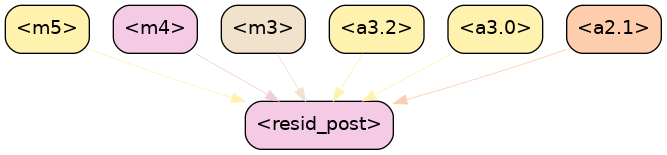

0 --------------------------------------------------
No edge 3723
3723
No edge 3723
New metric: 0.1886499971151352
No edge 3723
We moved to  blocks.5.hook_mlp_in[:]
No edge 3723


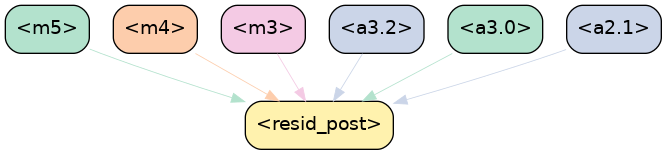

1 --------------------------------------------------
No edge 3723
3723
No edge 3723
New metric: 0.1886499971151352

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.hook_mlp_in, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 7] is 0.2511509656906128 (and current metric 0.1886499971151352)
Result is 0.0625009685754776...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.hook_mlp_in, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 6] is 0.2878994941711426 (and current metric 0.1886499971151352)
Result is 0.09924949705600739...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.5.hook_mlp_in, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 5] is 0.28411349654197693 (

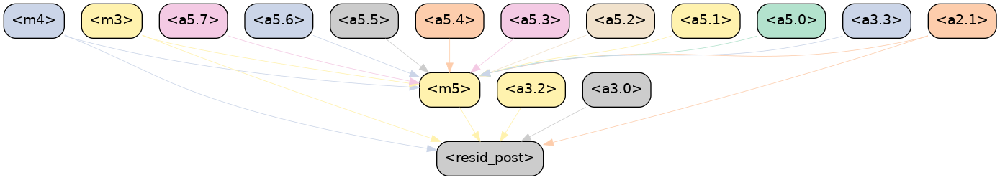

2 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 6]
No edge 3681


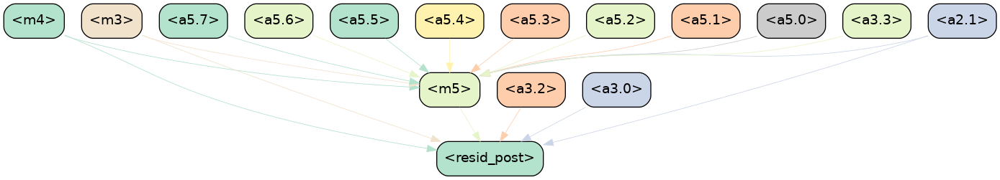

3 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 5]
No edge 3681


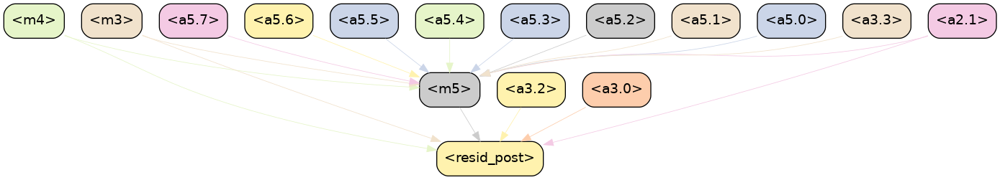

4 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 4]
No edge 3681


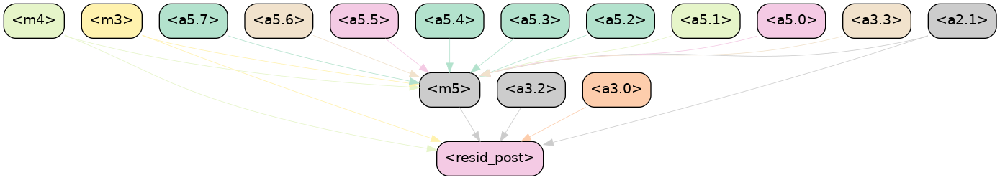

5 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 3]
No edge 3681


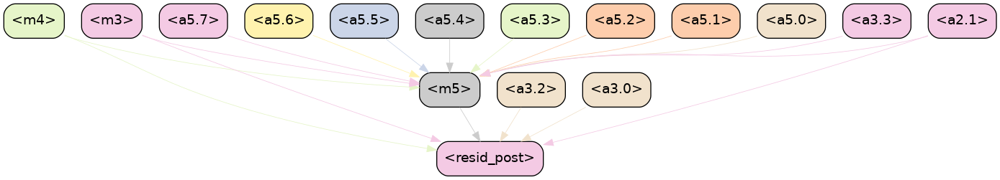

6 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 2]
No edge 3681


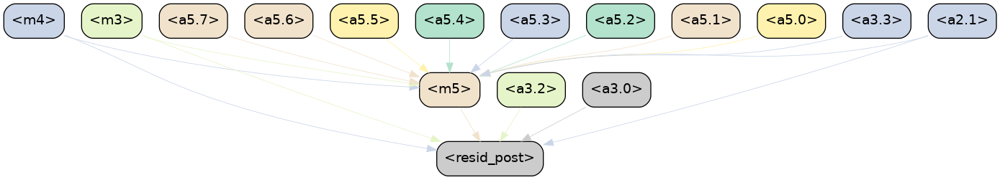

7 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 1]
No edge 3681


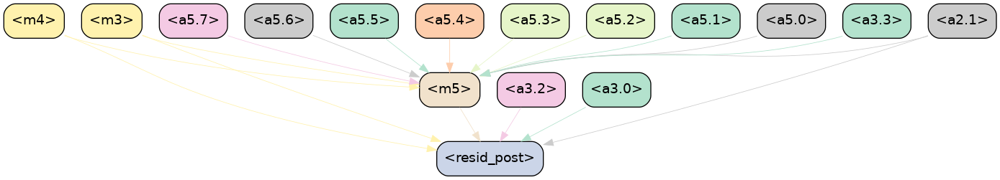

8 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_result[:, :, 0]
No edge 3681


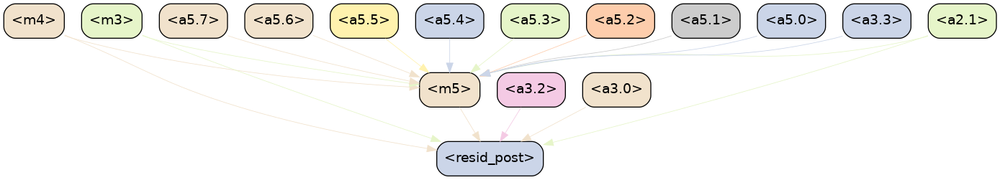

9 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824
No edge 3681
No edge 3681
No edge 3681
We moved to  blocks.5.attn.hook_v[:, :, 7]
No edge 3681


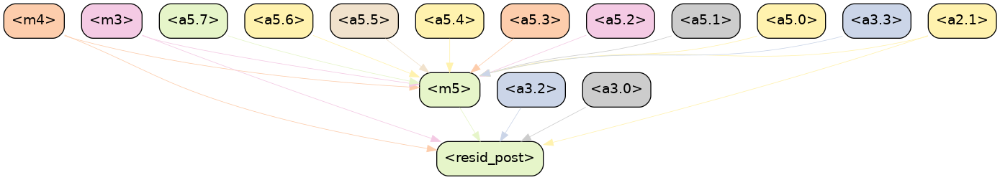

10 --------------------------------------------------
No edge 3681
3681
No edge 3681
New metric: 0.3996310234069824

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 7]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 7] is 0.37881720066070557 (and current metric 0.3996310234069824)
Result is -0.020813822746276855...so removing connection
No edge 3680
We moved to  blocks.5.attn.hook_v[:, :, 6]
No edge 3680


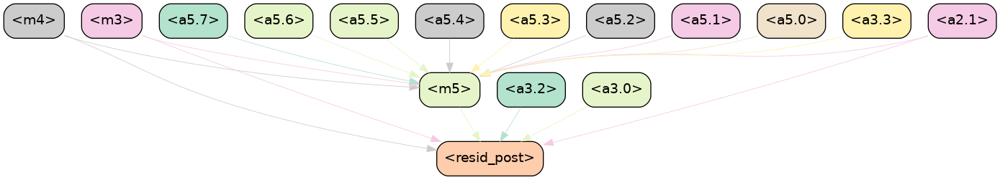

11 --------------------------------------------------
No edge 3680
3680
No edge 3680
New metric: 0.37881720066070557

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 6]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 6] is 0.3788171410560608 (and current metric 0.37881720066070557)
Result is -5.960464477539063e-08...so removing connection
No edge 3679
We moved to  blocks.5.attn.hook_v[:, :, 5]
No edge 3679


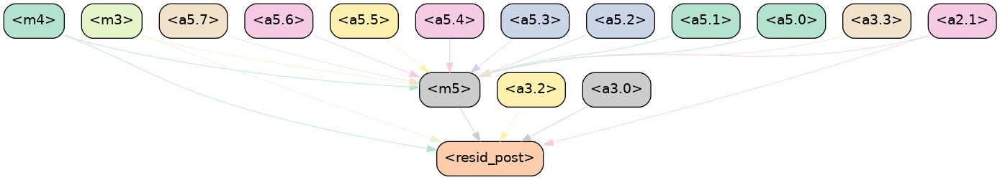

12 --------------------------------------------------
No edge 3679
3679
No edge 3679
New metric: 0.3788171410560608

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 5]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 5] is 0.37859025597572327 (and current metric 0.3788171410560608)
Result is -0.00022688508033752441...so removing connection
No edge 3678
We moved to  blocks.5.attn.hook_v[:, :, 4]
No edge 3678


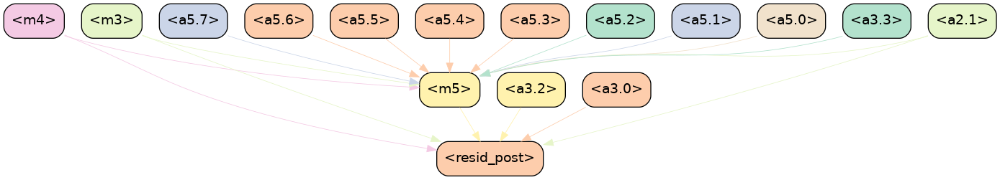

13 --------------------------------------------------
No edge 3678
3678
No edge 3678
New metric: 0.37859025597572327

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 4]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 4] is 0.3785945177078247 (and current metric 0.37859025597572327)
Result is 4.26173210144043e-06...so removing connection
No edge 3677
We moved to  blocks.5.attn.hook_v[:, :, 3]
No edge 3677


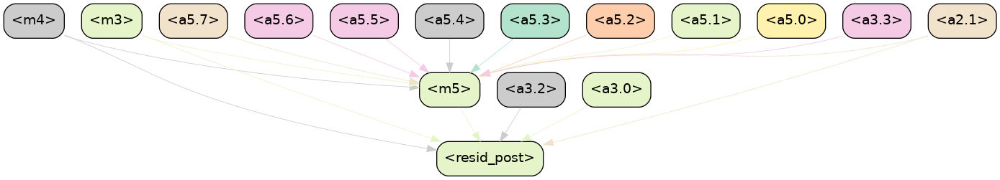

14 --------------------------------------------------
No edge 3677
3677
No edge 3677
New metric: 0.3785945177078247

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 3]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 3] is 0.3614504635334015 (and current metric 0.3785945177078247)
Result is -0.017144054174423218...so removing connection
No edge 3676
We moved to  blocks.5.attn.hook_v[:, :, 2]
No edge 3676


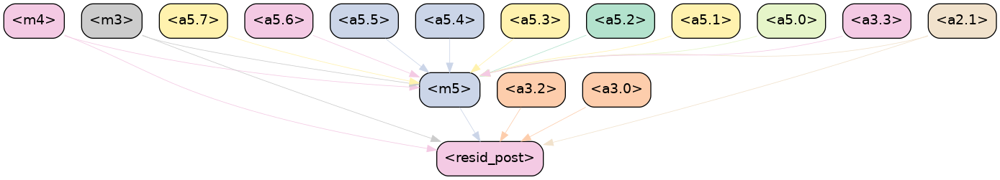

15 --------------------------------------------------
No edge 3676
3676
No edge 3676
New metric: 0.3614504635334015

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 2]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 2] is 0.3588271737098694 (and current metric 0.3614504635334015)
Result is -0.0026232898235321045...so removing connection
No edge 3675
We moved to  blocks.5.attn.hook_v[:, :, 1]
No edge 3675


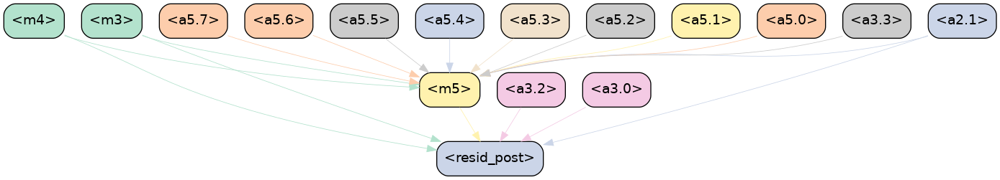

16 --------------------------------------------------
No edge 3675
3675
No edge 3675
New metric: 0.3588271737098694

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 1]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 1] is 0.3585748076438904 (and current metric 0.3588271737098694)
Result is -0.0002523660659790039...so removing connection
No edge 3674
We moved to  blocks.5.attn.hook_v[:, :, 0]
No edge 3674


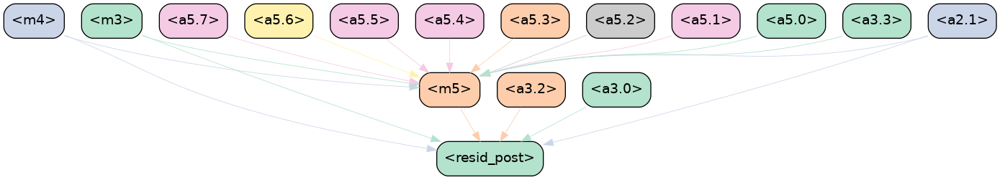

17 --------------------------------------------------
No edge 3674
3674
No edge 3674
New metric: 0.3585748076438904

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_v_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_v, [:, :, 0]))

Metric after removing connection to blocks.5.hook_v_input [:, :, 0] is 0.35836783051490784 (and current metric 0.3585748076438904)
Result is -0.00020697712898254395...so removing connection
No edge 3673
We moved to  blocks.5.attn.hook_k[:, :, 7]
No edge 3673


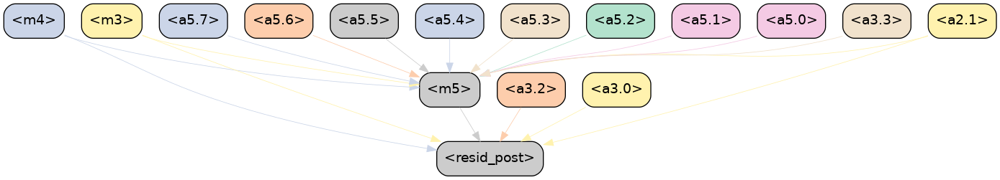

18 --------------------------------------------------
No edge 3673
3673
No edge 3673
New metric: 0.35836783051490784

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 7]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 7] is 0.35383281111717224 (and current metric 0.35836783051490784)
Result is -0.004535019397735596...so removing connection
No edge 3672
We moved to  blocks.5.attn.hook_k[:, :, 6]
No edge 3672


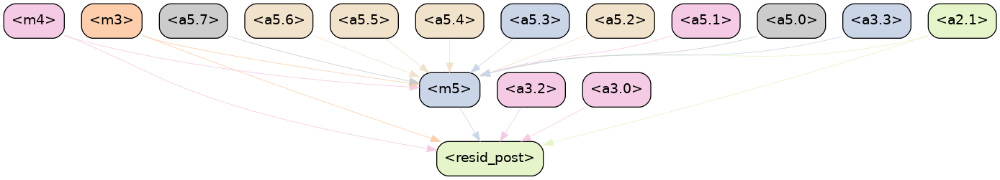

19 --------------------------------------------------
No edge 3672
3672
No edge 3672
New metric: 0.35383281111717224

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 6]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 6] is 0.35363462567329407 (and current metric 0.35383281111717224)
Result is -0.00019818544387817383...so removing connection
No edge 3671
We moved to  blocks.5.attn.hook_k[:, :, 5]
No edge 3671


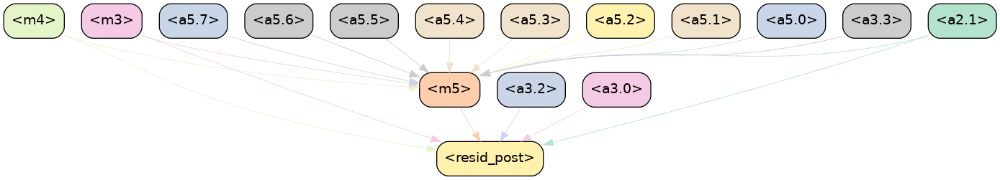

20 --------------------------------------------------
No edge 3671
3671
No edge 3671
New metric: 0.35363462567329407

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 5]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 5] is 0.3514059782028198 (and current metric 0.35363462567329407)
Result is -0.002228647470474243...so removing connection
No edge 3670
We moved to  blocks.5.attn.hook_k[:, :, 4]
No edge 3670


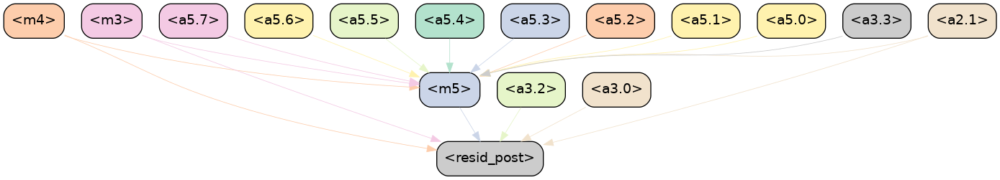

21 --------------------------------------------------
No edge 3670
3670
No edge 3670
New metric: 0.3514059782028198

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 4]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 4] is 0.3515335023403168 (and current metric 0.3514059782028198)
Result is 0.00012752413749694824...so removing connection
No edge 3669
We moved to  blocks.5.attn.hook_k[:, :, 3]
No edge 3669


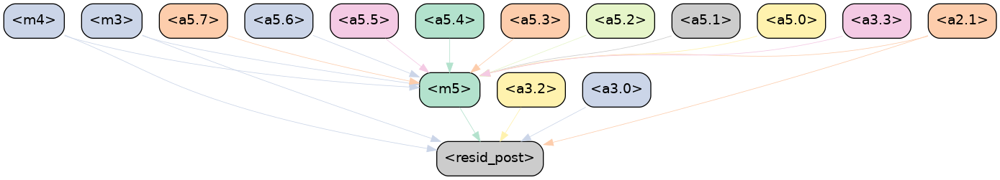

22 --------------------------------------------------
No edge 3669
3669
No edge 3669
New metric: 0.3515335023403168

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 3]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 3] is 0.3407897353172302 (and current metric 0.3515335023403168)
Result is -0.010743767023086548...so removing connection
No edge 3668
We moved to  blocks.5.attn.hook_k[:, :, 2]
No edge 3668


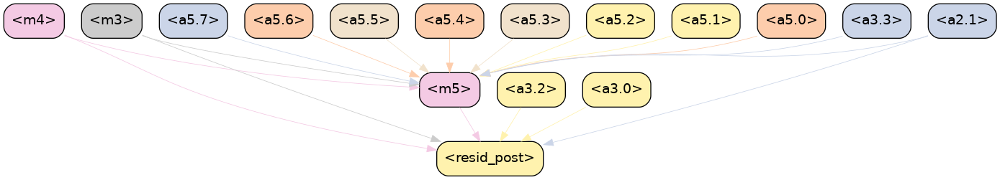

23 --------------------------------------------------
No edge 3668
3668
No edge 3668
New metric: 0.3407897353172302

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 2]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 2] is 0.33647701144218445 (and current metric 0.3407897353172302)
Result is -0.004312723875045776...so removing connection
No edge 3667
We moved to  blocks.5.attn.hook_k[:, :, 1]
No edge 3667


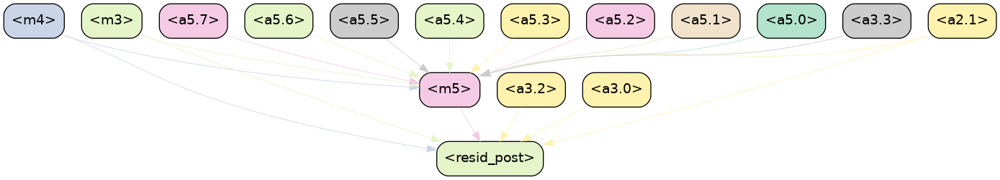

24 --------------------------------------------------
No edge 3667
3667
No edge 3667
New metric: 0.33647701144218445

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 1]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 1] is 0.34041568636894226 (and current metric 0.33647701144218445)
Result is 0.0039386749267578125...so removing connection
No edge 3666
We moved to  blocks.5.attn.hook_k[:, :, 0]
No edge 3666


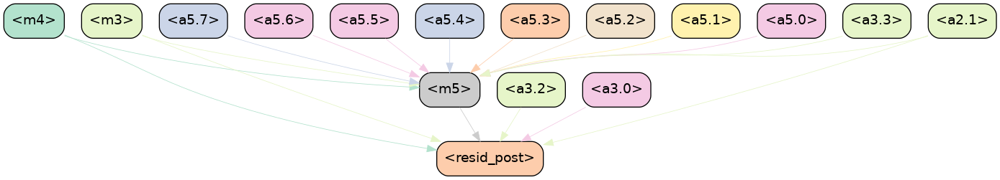

25 --------------------------------------------------
No edge 3666
3666
No edge 3666
New metric: 0.34041568636894226

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_k_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_k, [:, :, 0]))

Metric after removing connection to blocks.5.hook_k_input [:, :, 0] is 0.3401044011116028 (and current metric 0.34041568636894226)
Result is -0.00031128525733947754...so removing connection
No edge 3665
We moved to  blocks.5.attn.hook_q[:, :, 7]
No edge 3665


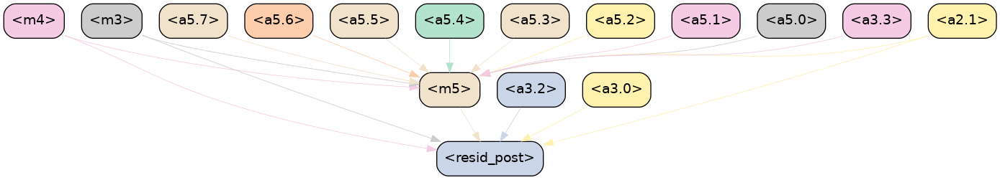

26 --------------------------------------------------
No edge 3665
3665
No edge 3665
New metric: 0.3401044011116028

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 7]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 7] is 0.33944401144981384 (and current metric 0.3401044011116028)
Result is -0.0006603896617889404...so removing connection
No edge 3664
We moved to  blocks.5.attn.hook_q[:, :, 6]
No edge 3664


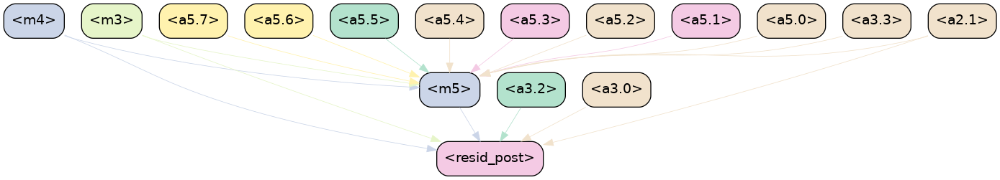

27 --------------------------------------------------
No edge 3664
3664
No edge 3664
New metric: 0.33944401144981384

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 6]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 6] is 0.3394377827644348 (and current metric 0.33944401144981384)
Result is -6.22868537902832e-06...so removing connection
No edge 3663
We moved to  blocks.5.attn.hook_q[:, :, 5]
No edge 3663


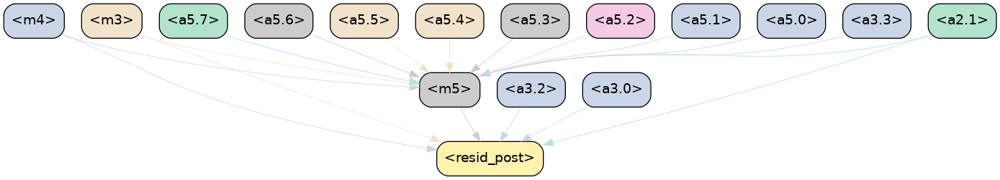

28 --------------------------------------------------
No edge 3663
3663
No edge 3663
New metric: 0.3394377827644348

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 5]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 5] is 0.3397825062274933 (and current metric 0.3394377827644348)
Result is 0.0003447234630584717...so removing connection
No edge 3662
We moved to  blocks.5.attn.hook_q[:, :, 4]
No edge 3662


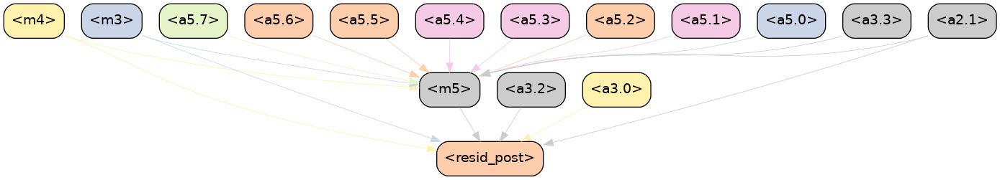

29 --------------------------------------------------
No edge 3662
3662
No edge 3662
New metric: 0.3397825062274933

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 4]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 4] is 0.33978161215782166 (and current metric 0.3397825062274933)
Result is -8.940696716308594e-07...so removing connection
No edge 3661
We moved to  blocks.5.attn.hook_q[:, :, 3]
No edge 3661


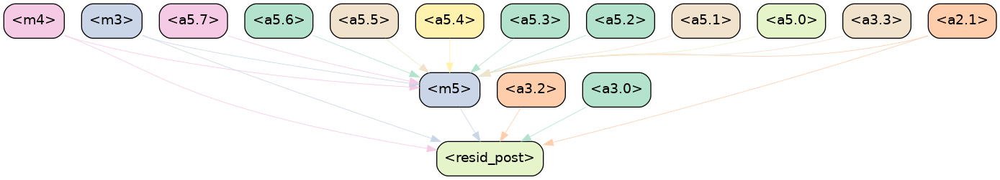

30 --------------------------------------------------
No edge 3661
3661
No edge 3661
New metric: 0.33978161215782166

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 3]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 3] is 0.3376157283782959 (and current metric 0.33978161215782166)
Result is -0.002165883779525757...so removing connection
No edge 3660
We moved to  blocks.5.attn.hook_q[:, :, 2]
No edge 3660


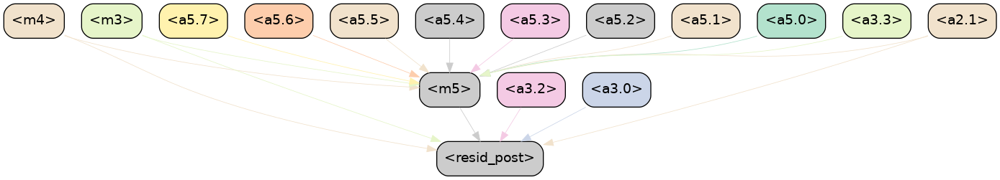

31 --------------------------------------------------
No edge 3660
3660
No edge 3660
New metric: 0.3376157283782959

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 2]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 2] is 0.3408931791782379 (and current metric 0.3376157283782959)
Result is 0.0032774507999420166...so removing connection
No edge 3659
We moved to  blocks.5.attn.hook_q[:, :, 1]
No edge 3659


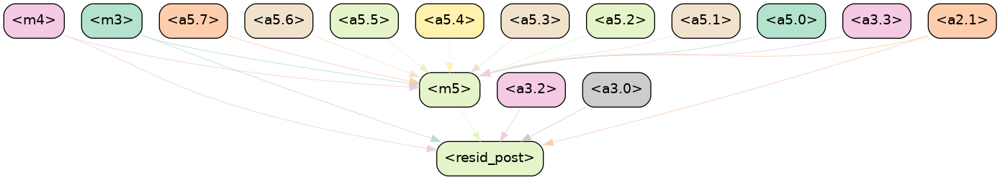

32 --------------------------------------------------
No edge 3659
3659
No edge 3659
New metric: 0.3408931791782379

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 1]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 1] is 0.3253730237483978 (and current metric 0.3408931791782379)
Result is -0.015520155429840088...so removing connection
No edge 3658
We moved to  blocks.5.attn.hook_q[:, :, 0]
No edge 3658


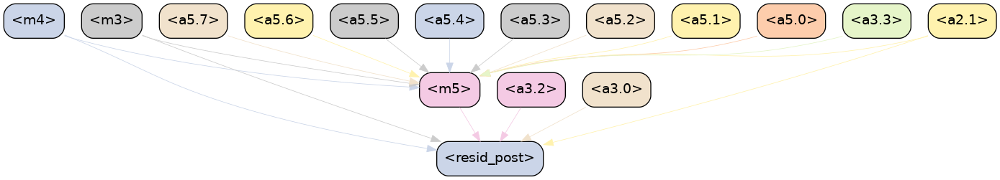

33 --------------------------------------------------
No edge 3658
3658
No edge 3658
New metric: 0.3253730237483978

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_q_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.5.attn.hook_q, [:, :, 0]))

Metric after removing connection to blocks.5.hook_q_input [:, :, 0] is 0.3318077027797699 (and current metric 0.3253730237483978)
Result is 0.00643467903137207...so removing connection
No edge 3657
We moved to  blocks.5.hook_v_input[:, :, 7]
No edge 3657
No edge 3611
But it's bad
We moved to  blocks.5.hook_v_input[:, :, 6]
No edge 3611
No edge 3565
But it's bad
We moved to  blocks.5.hook_v_input[:, :, 5]
No edge 3565
No edge 3519
But it's bad
We moved to  blocks.5.hook_v_input[:, :, 4]
No edge 3519
No edge 3473
But it's bad
We moved to  blocks.5.hook_v_input[:, :, 3]
No edge 3473
No edge 3427
But it's bad
We moved to  blocks.5.hook_v_input[:, :, 2]
No edge 3427
No edge 3381
But it's bad
We moved to  blocks.5.hook_v_input[:, :, 1]
No e

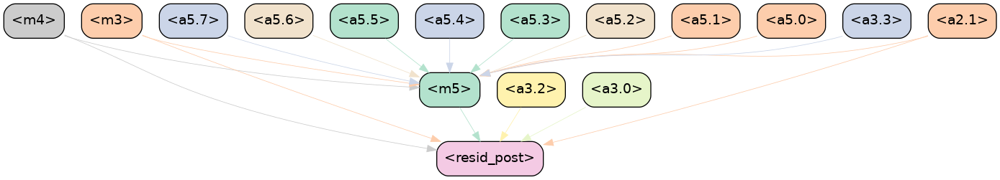

34 --------------------------------------------------
No edge 2553
2553
No edge 2553
New metric: 0.3318077027797699
No edge 2553
We moved to  blocks.4.hook_mlp_in[:]
No edge 2553


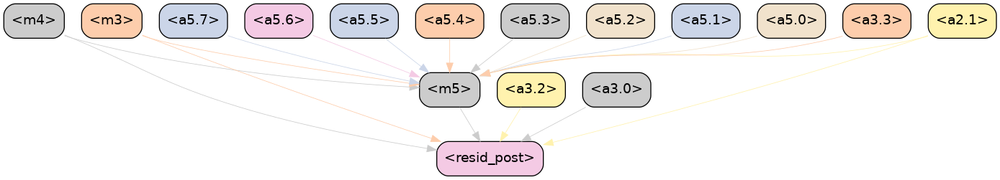

35 --------------------------------------------------
No edge 2553
2553
No edge 2553
New metric: 0.3318077027797699

Node: cur_parent=TLACDCInterpNode(blocks.4.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.hook_mlp_in, [:]))

Metric after removing connection to blocks.4.attn.hook_result [:, :, 7] is 0.3924578130245209 (and current metric 0.3318077027797699)
Result is 0.06065011024475098...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.4.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.hook_mlp_in, [:]))

Metric after removing connection to blocks.4.attn.hook_result [:, :, 6] is 0.3865273892879486 (and current metric 0.3318077027797699)
Result is 0.05471968650817871...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.4.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.4.hook_mlp_in, [:]))

Metric after removing connection to blocks.4.attn.hook_result [:, :, 5] is 0.37114232778549194

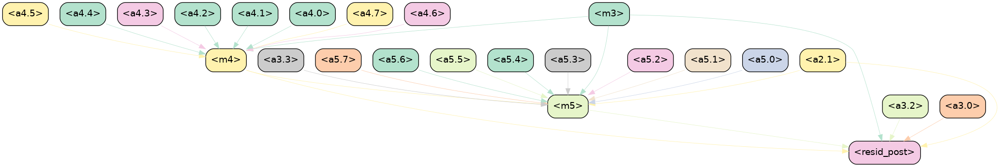

36 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 6]
No edge 2517


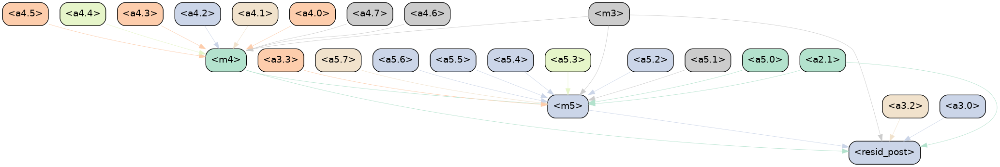

37 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 5]
No edge 2517


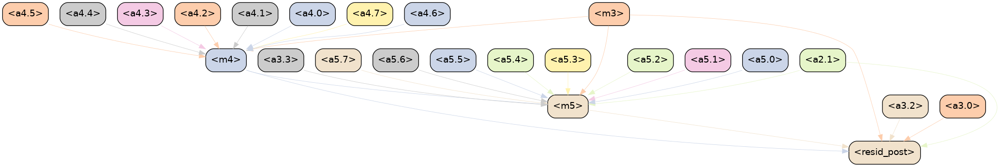

38 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 4]
No edge 2517


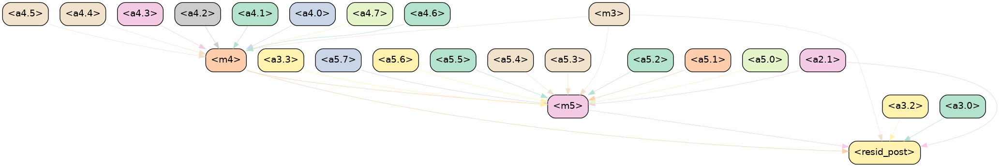

39 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 3]
No edge 2517


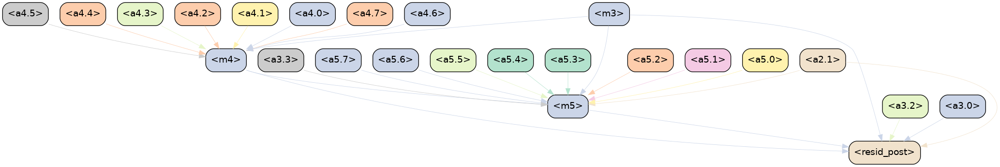

40 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 2]
No edge 2517


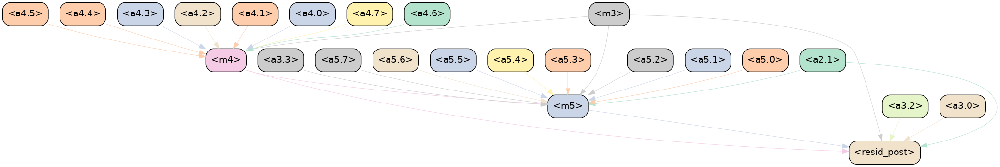

41 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 1]
No edge 2517


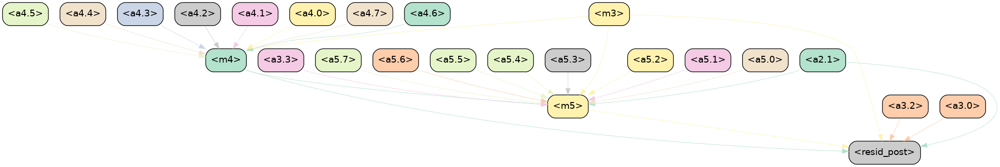

42 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_result[:, :, 0]
No edge 2517


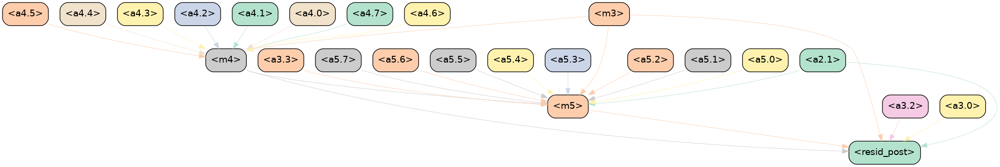

43 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476
No edge 2517
No edge 2517
No edge 2517
We moved to  blocks.4.attn.hook_v[:, :, 7]
No edge 2517


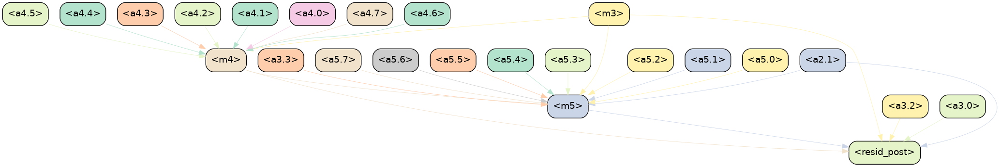

44 --------------------------------------------------
No edge 2517
2517
No edge 2517
New metric: 0.4652225375175476

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 7]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 7] is 0.4656786322593689 (and current metric 0.4652225375175476)
Result is 0.00045609474182128906...so removing connection
No edge 2516
We moved to  blocks.4.attn.hook_v[:, :, 6]
No edge 2516


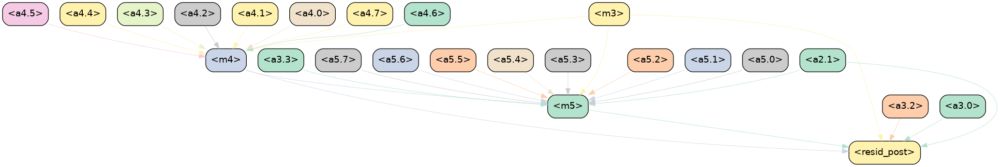

45 --------------------------------------------------
No edge 2516
2516
No edge 2516
New metric: 0.4656786322593689

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 6]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 6] is 0.4651605486869812 (and current metric 0.4656786322593689)
Result is -0.0005180835723876953...so removing connection
No edge 2515
We moved to  blocks.4.attn.hook_v[:, :, 5]
No edge 2515


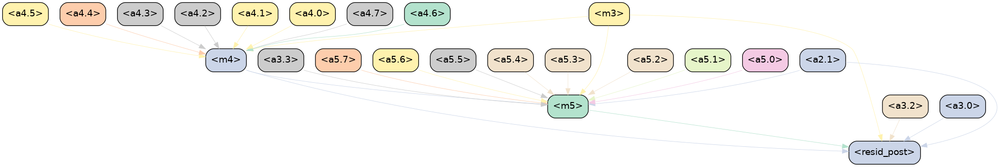

46 --------------------------------------------------
No edge 2515
2515
No edge 2515
New metric: 0.4651605486869812

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 5]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 5] is 0.46096885204315186 (and current metric 0.4651605486869812)
Result is -0.004191696643829346...so removing connection
No edge 2514
We moved to  blocks.4.attn.hook_v[:, :, 4]
No edge 2514


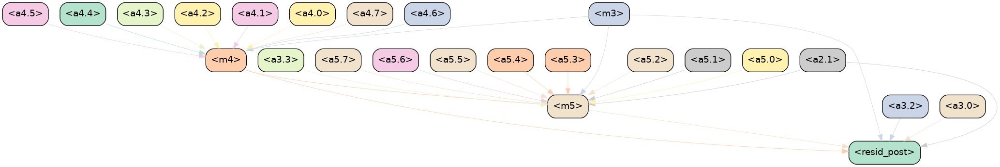

47 --------------------------------------------------
No edge 2514
2514
No edge 2514
New metric: 0.46096885204315186

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 4]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 4] is 0.46156278252601624 (and current metric 0.46096885204315186)
Result is 0.0005939304828643799...so removing connection
No edge 2513
We moved to  blocks.4.attn.hook_v[:, :, 3]
No edge 2513


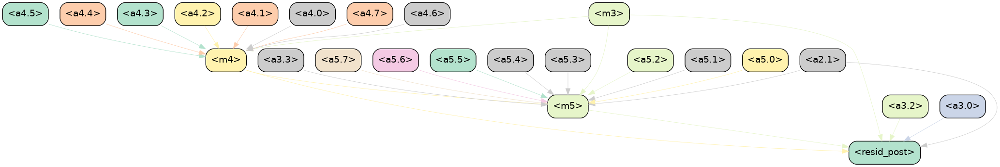

48 --------------------------------------------------
No edge 2513
2513
No edge 2513
New metric: 0.46156278252601624

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 3]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 3] is 0.45761722326278687 (and current metric 0.46156278252601624)
Result is -0.00394555926322937...so removing connection
No edge 2512
We moved to  blocks.4.attn.hook_v[:, :, 2]
No edge 2512


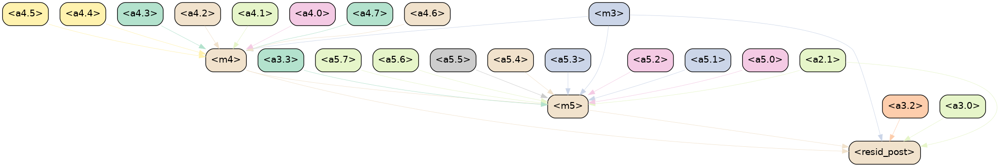

49 --------------------------------------------------
No edge 2512
2512
No edge 2512
New metric: 0.45761722326278687

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 2]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 2] is 0.45730963349342346 (and current metric 0.45761722326278687)
Result is -0.0003075897693634033...so removing connection
No edge 2511
We moved to  blocks.4.attn.hook_v[:, :, 1]
No edge 2511


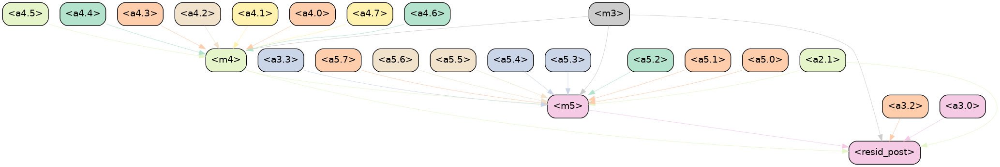

50 --------------------------------------------------
No edge 2511
2511
No edge 2511
New metric: 0.45730963349342346

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 1]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 1] is 0.4591536521911621 (and current metric 0.45730963349342346)
Result is 0.0018440186977386475...so removing connection
No edge 2510
We moved to  blocks.4.attn.hook_v[:, :, 0]
No edge 2510


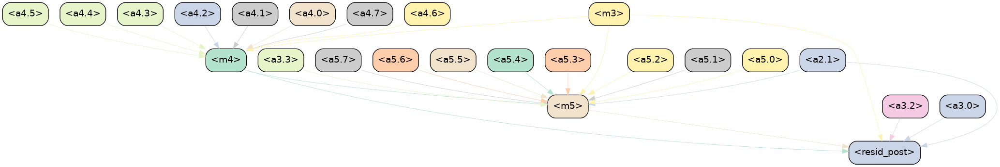

51 --------------------------------------------------
No edge 2510
2510
No edge 2510
New metric: 0.4591536521911621

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 0]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 0] is 0.45446616411209106 (and current metric 0.4591536521911621)
Result is -0.004687488079071045...so removing connection
No edge 2509
We moved to  blocks.4.attn.hook_k[:, :, 7]
No edge 2509


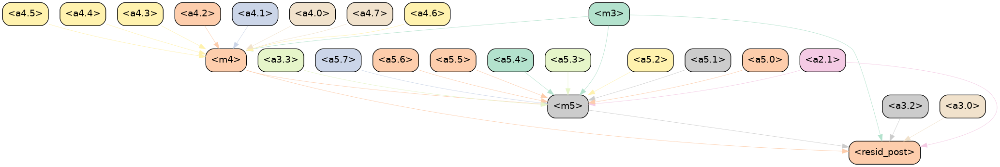

52 --------------------------------------------------
No edge 2509
2509
No edge 2509
New metric: 0.45446616411209106

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 7]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 7] is 0.4600026607513428 (and current metric 0.45446616411209106)
Result is 0.005536496639251709...so removing connection
No edge 2508
We moved to  blocks.4.attn.hook_k[:, :, 6]
No edge 2508


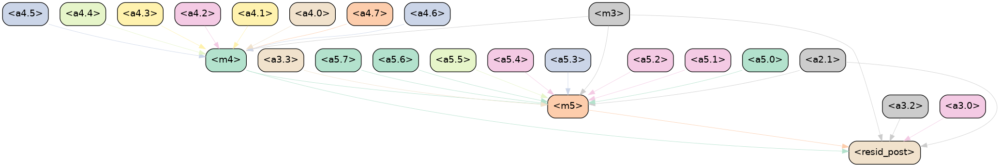

53 --------------------------------------------------
No edge 2508
2508
No edge 2508
New metric: 0.4600026607513428

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 6]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 6] is 0.45659902691841125 (and current metric 0.4600026607513428)
Result is -0.0034036338329315186...so removing connection
No edge 2507
We moved to  blocks.4.attn.hook_k[:, :, 5]
No edge 2507


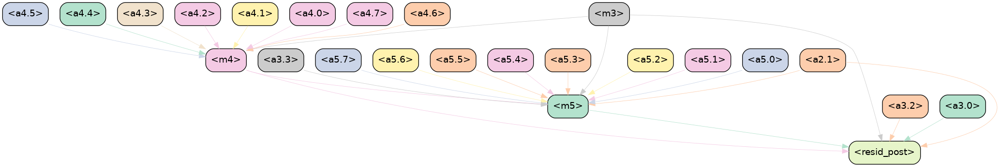

54 --------------------------------------------------
No edge 2507
2507
No edge 2507
New metric: 0.45659902691841125

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 5]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 5] is 0.4510643780231476 (and current metric 0.45659902691841125)
Result is -0.005534648895263672...so removing connection
No edge 2506
We moved to  blocks.4.attn.hook_k[:, :, 4]
No edge 2506


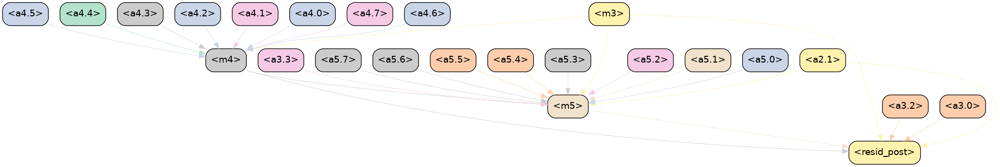

55 --------------------------------------------------
No edge 2506
2506
No edge 2506
New metric: 0.4510643780231476

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 4]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 4] is 0.4498806297779083 (and current metric 0.4510643780231476)
Result is -0.0011837482452392578...so removing connection
No edge 2505
We moved to  blocks.4.attn.hook_k[:, :, 3]
No edge 2505


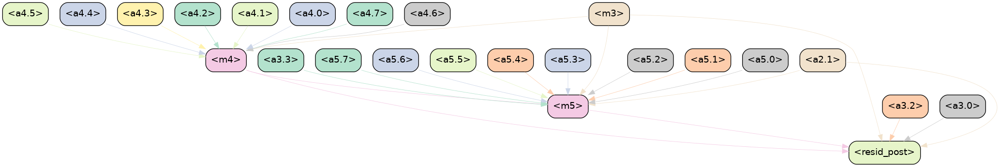

56 --------------------------------------------------
No edge 2505
2505
No edge 2505
New metric: 0.4498806297779083

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 3]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 3] is 0.446419894695282 (and current metric 0.4498806297779083)
Result is -0.0034607350826263428...so removing connection
No edge 2504
We moved to  blocks.4.attn.hook_k[:, :, 2]
No edge 2504


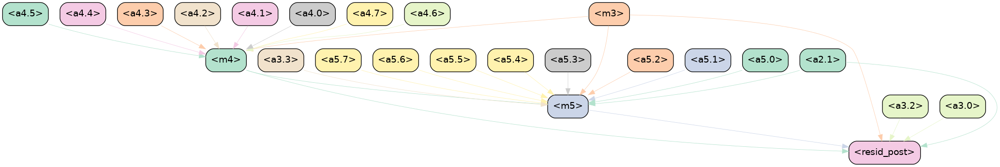

57 --------------------------------------------------
No edge 2504
2504
No edge 2504
New metric: 0.446419894695282

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 2]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 2] is 0.44450119137763977 (and current metric 0.446419894695282)
Result is -0.001918703317642212...so removing connection
No edge 2503
We moved to  blocks.4.attn.hook_k[:, :, 1]
No edge 2503


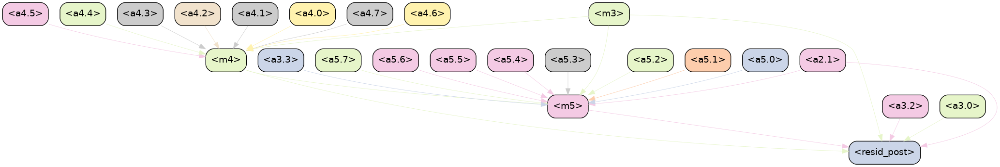

58 --------------------------------------------------
No edge 2503
2503
No edge 2503
New metric: 0.44450119137763977

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 1]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 1] is 0.4416292905807495 (and current metric 0.44450119137763977)
Result is -0.002871900796890259...so removing connection
No edge 2502
We moved to  blocks.4.attn.hook_k[:, :, 0]
No edge 2502


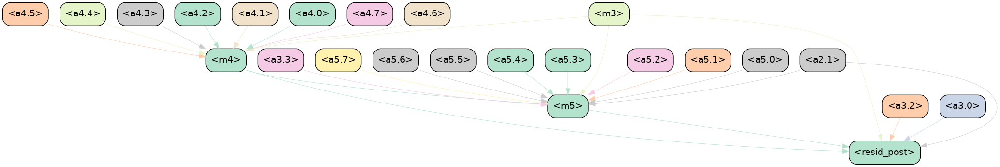

59 --------------------------------------------------
No edge 2502
2502
No edge 2502
New metric: 0.4416292905807495

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 0]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 0] is 0.43766123056411743 (and current metric 0.4416292905807495)
Result is -0.00396806001663208...so removing connection
No edge 2501
We moved to  blocks.4.attn.hook_q[:, :, 7]
No edge 2501


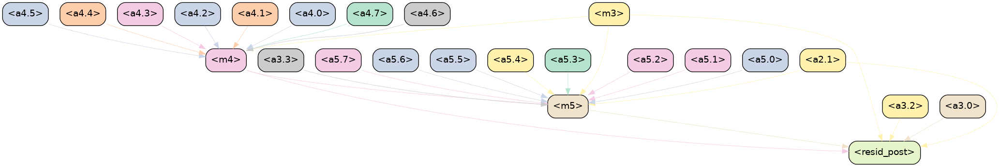

60 --------------------------------------------------
No edge 2501
2501
No edge 2501
New metric: 0.43766123056411743

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 7]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 7] is 0.43619024753570557 (and current metric 0.43766123056411743)
Result is -0.0014709830284118652...so removing connection
No edge 2500
We moved to  blocks.4.attn.hook_q[:, :, 6]
No edge 2500


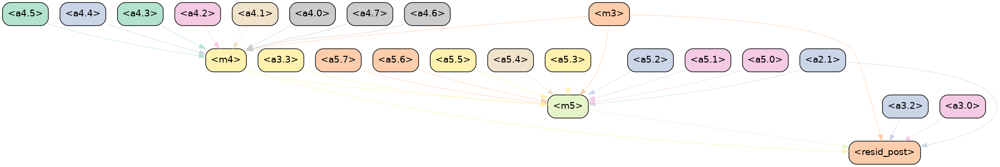

61 --------------------------------------------------
No edge 2500
2500
No edge 2500
New metric: 0.43619024753570557

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 6]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 6] is 0.4375350773334503 (and current metric 0.43619024753570557)
Result is 0.001344829797744751...so removing connection
No edge 2499
We moved to  blocks.4.attn.hook_q[:, :, 5]
No edge 2499


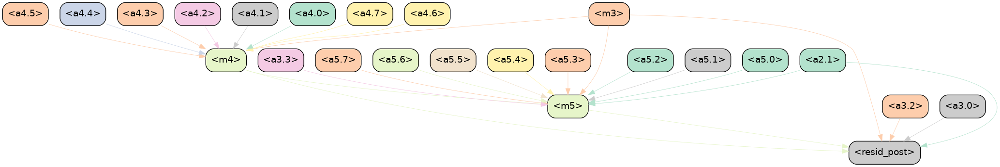

62 --------------------------------------------------
No edge 2499
2499
No edge 2499
New metric: 0.4375350773334503

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 5]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 5] is 0.43542295694351196 (and current metric 0.4375350773334503)
Result is -0.0021121203899383545...so removing connection
No edge 2498
We moved to  blocks.4.attn.hook_q[:, :, 4]
No edge 2498


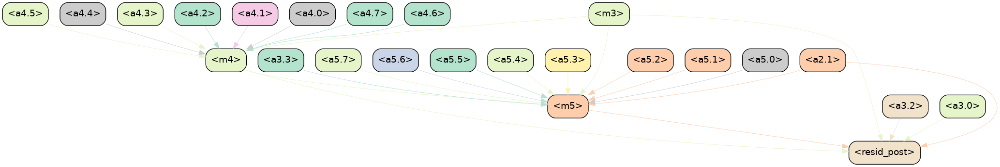

63 --------------------------------------------------
No edge 2498
2498
No edge 2498
New metric: 0.43542295694351196

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 4]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 4] is 0.43576979637145996 (and current metric 0.43542295694351196)
Result is 0.00034683942794799805...so removing connection
No edge 2497
We moved to  blocks.4.attn.hook_q[:, :, 3]
No edge 2497


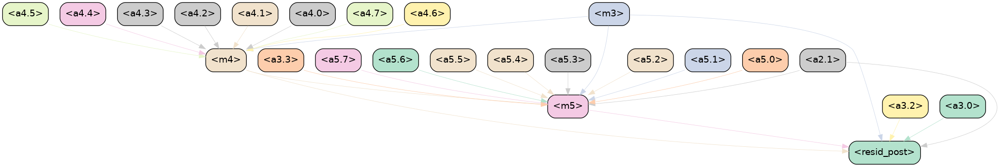

64 --------------------------------------------------
No edge 2497
2497
No edge 2497
New metric: 0.43576979637145996

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 3]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 3] is 0.43369728326797485 (and current metric 0.43576979637145996)
Result is -0.0020725131034851074...so removing connection
No edge 2496
We moved to  blocks.4.attn.hook_q[:, :, 2]
No edge 2496


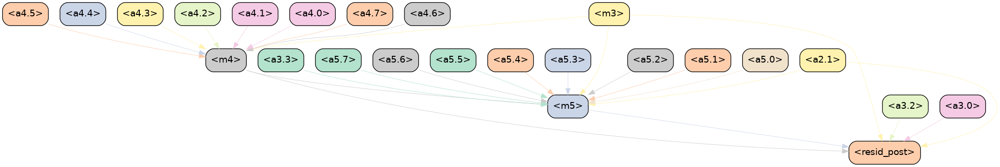

65 --------------------------------------------------
No edge 2496
2496
No edge 2496
New metric: 0.43369728326797485

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 2]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 2] is 0.4339253008365631 (and current metric 0.43369728326797485)
Result is 0.00022801756858825684...so removing connection
No edge 2495
We moved to  blocks.4.attn.hook_q[:, :, 1]
No edge 2495


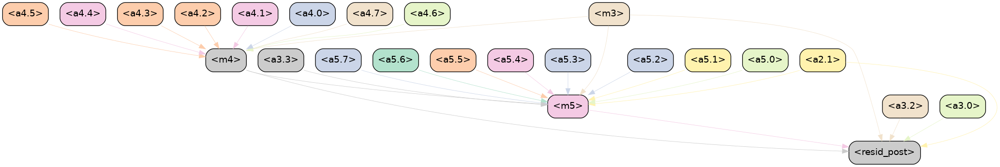

66 --------------------------------------------------
No edge 2495
2495
No edge 2495
New metric: 0.4339253008365631

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 1]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 1] is 0.42341339588165283 (and current metric 0.4339253008365631)
Result is -0.010511904954910278...so removing connection
No edge 2494
We moved to  blocks.4.attn.hook_q[:, :, 0]
No edge 2494


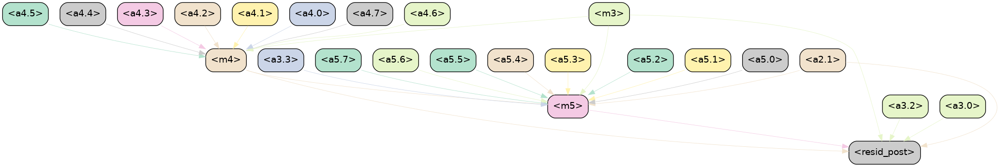

67 --------------------------------------------------
No edge 2494
2494
No edge 2494
New metric: 0.42341339588165283

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 0]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 0] is 0.42294833064079285 (and current metric 0.42341339588165283)
Result is -0.00046506524085998535...so removing connection
No edge 2493
We moved to  blocks.4.hook_v_input[:, :, 7]
No edge 2493
No edge 2456
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 6]
No edge 2456
No edge 2419
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 5]
No edge 2419
No edge 2382
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 4]
No edge 2382
No edge 2345
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 3]
No edge 2345
No edge 2308
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 2]
No edge 2308
No edge 2271
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 

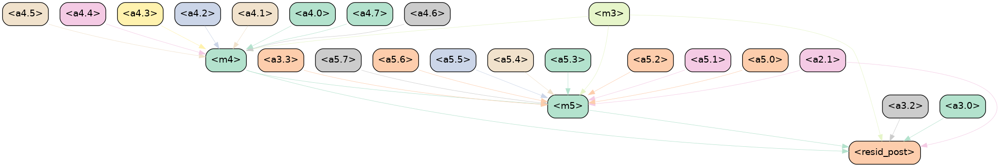

68 --------------------------------------------------
No edge 1605
1605
No edge 1605
New metric: 0.42294833064079285
No edge 1605
We moved to  blocks.3.hook_mlp_in[:]
No edge 1605


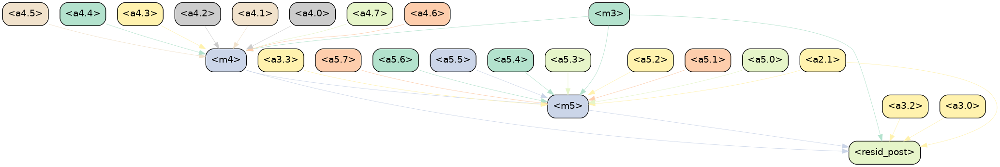

69 --------------------------------------------------
No edge 1605
1605
No edge 1605
New metric: 0.42294833064079285

Node: cur_parent=TLACDCInterpNode(blocks.3.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.3.hook_mlp_in, [:]))

Metric after removing connection to blocks.3.attn.hook_result [:, :, 7] is 0.5808672904968262 (and current metric 0.42294833064079285)
Result is 0.15791895985603333...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.3.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.3.hook_mlp_in, [:]))

Metric after removing connection to blocks.3.attn.hook_result [:, :, 6] is 0.5876010656356812 (and current metric 0.42294833064079285)
Result is 0.1646527349948883...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.3.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.3.hook_mlp_in, [:]))

Metric after removing connection to blocks.3.attn.hook_result [:, :, 5] is 0.589102983474731

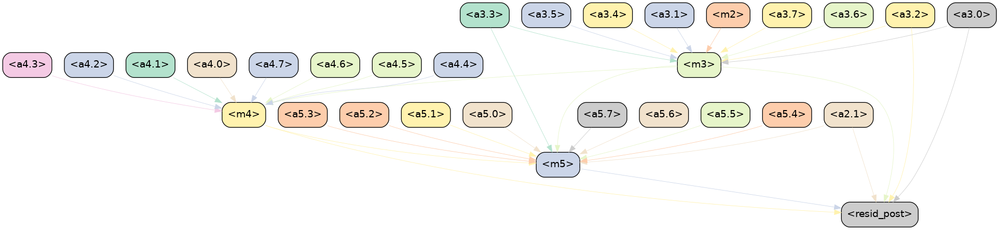

70 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 6]
No edge 1578


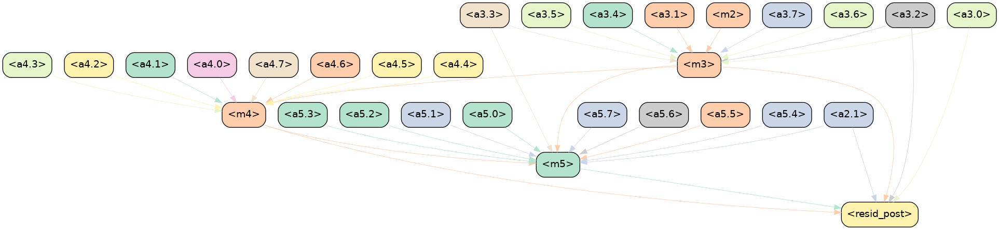

71 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 5]
No edge 1578


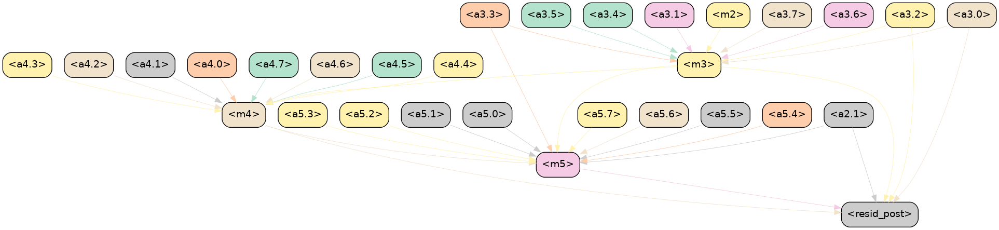

72 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 4]
No edge 1578


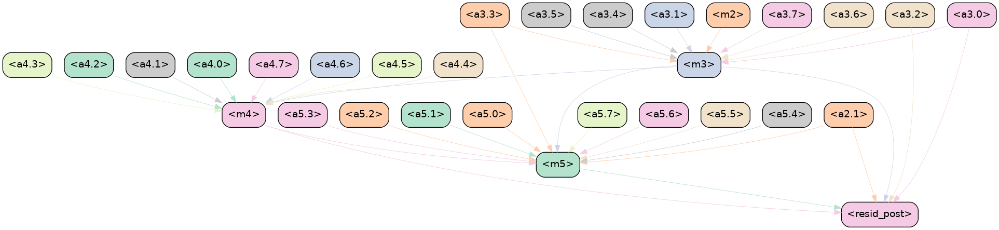

73 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 3]
No edge 1578


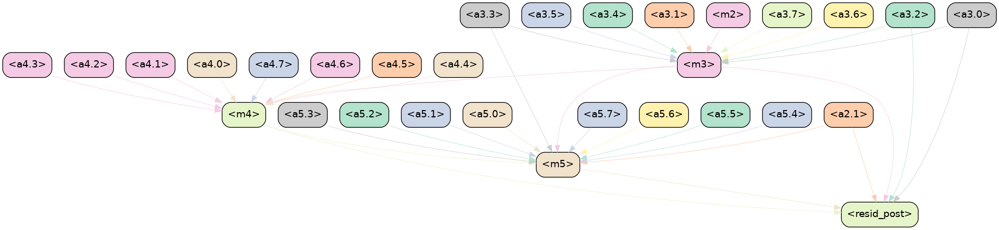

74 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 2]
No edge 1578


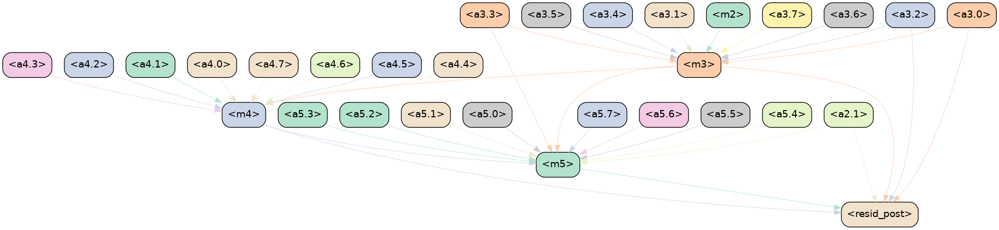

75 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 1]
No edge 1578


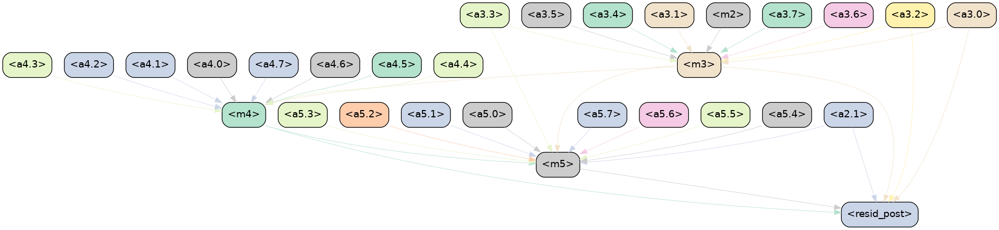

76 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_result[:, :, 0]
No edge 1578


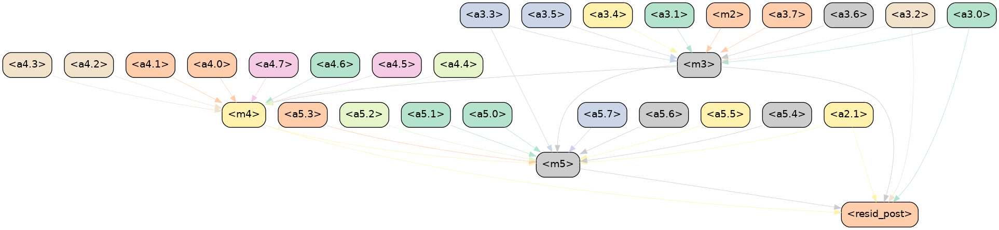

77 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196
No edge 1578
No edge 1578
No edge 1578
We moved to  blocks.3.attn.hook_v[:, :, 7]
No edge 1578


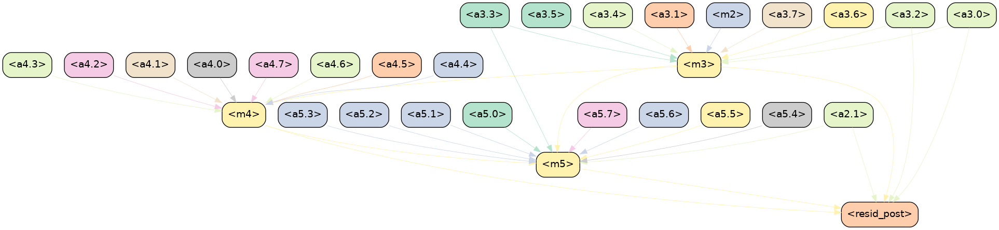

78 --------------------------------------------------
No edge 1578
1578
No edge 1578
New metric: 0.5650449991226196

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 7]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 7] is 0.5529120564460754 (and current metric 0.5650449991226196)
Result is -0.01213294267654419...so removing connection
No edge 1577
We moved to  blocks.3.attn.hook_v[:, :, 6]
No edge 1577


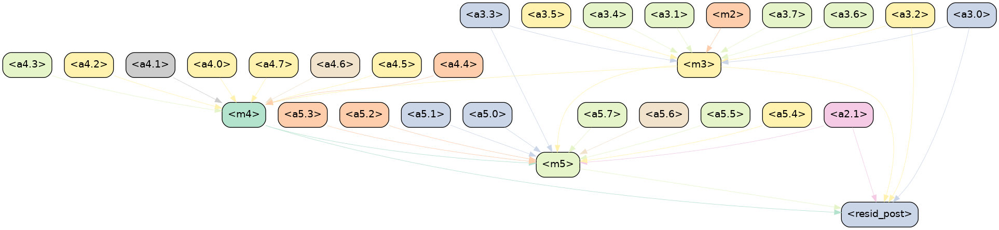

79 --------------------------------------------------
No edge 1577
1577
No edge 1577
New metric: 0.5529120564460754

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 6]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 6] is 0.5521995425224304 (and current metric 0.5529120564460754)
Result is -0.0007125139236450195...so removing connection
No edge 1576
We moved to  blocks.3.attn.hook_v[:, :, 5]
No edge 1576


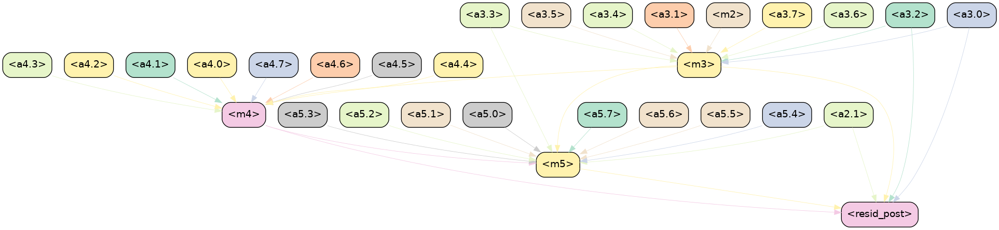

80 --------------------------------------------------
No edge 1576
1576
No edge 1576
New metric: 0.5521995425224304

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 5]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 5] is 0.5510880351066589 (and current metric 0.5521995425224304)
Result is -0.0011115074157714844...so removing connection
No edge 1575
We moved to  blocks.3.attn.hook_v[:, :, 4]
No edge 1575


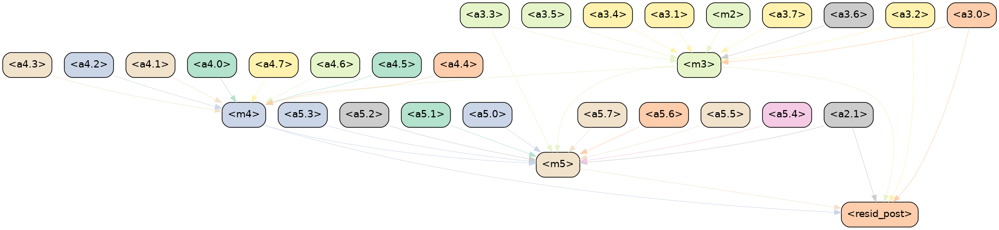

81 --------------------------------------------------
No edge 1575
1575
No edge 1575
New metric: 0.5510880351066589

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 4]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 4] is 0.5397481918334961 (and current metric 0.5510880351066589)
Result is -0.011339843273162842...so removing connection
No edge 1574
We moved to  blocks.3.attn.hook_v[:, :, 3]
No edge 1574


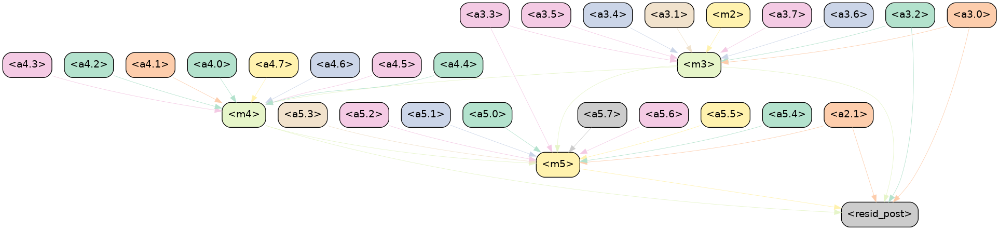

82 --------------------------------------------------
No edge 1574
1574
No edge 1574
New metric: 0.5397481918334961

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 3]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 3] is 0.5423579812049866 (and current metric 0.5397481918334961)
Result is 0.0026097893714904785...so removing connection
No edge 1573
We moved to  blocks.3.attn.hook_v[:, :, 2]
No edge 1573


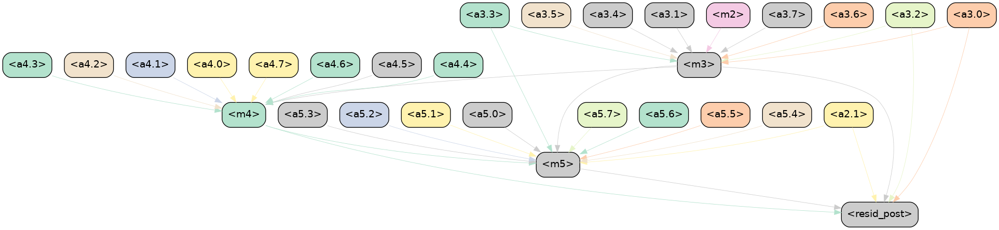

83 --------------------------------------------------
No edge 1573
1573
No edge 1573
New metric: 0.5423579812049866

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 2]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 2] is 0.5489774346351624 (and current metric 0.5423579812049866)
Result is 0.006619453430175781...so removing connection
No edge 1572
We moved to  blocks.3.attn.hook_v[:, :, 1]
No edge 1572


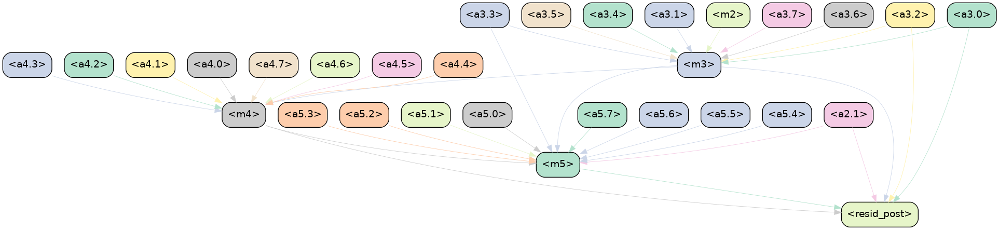

84 --------------------------------------------------
No edge 1572
1572
No edge 1572
New metric: 0.5489774346351624

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 1]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 1] is 0.5406652688980103 (and current metric 0.5489774346351624)
Result is -0.0083121657371521...so removing connection
No edge 1571
We moved to  blocks.3.attn.hook_v[:, :, 0]
No edge 1571


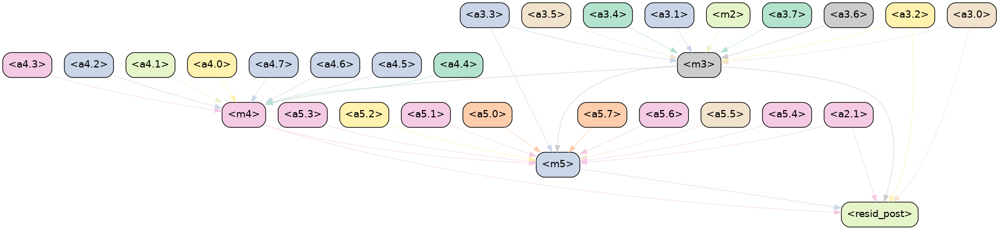

85 --------------------------------------------------
No edge 1571
1571
No edge 1571
New metric: 0.5406652688980103

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_v_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_v, [:, :, 0]))

Metric after removing connection to blocks.3.hook_v_input [:, :, 0] is 0.5421532988548279 (and current metric 0.5406652688980103)
Result is 0.001488029956817627...so removing connection
No edge 1570
We moved to  blocks.3.attn.hook_k[:, :, 7]
No edge 1570


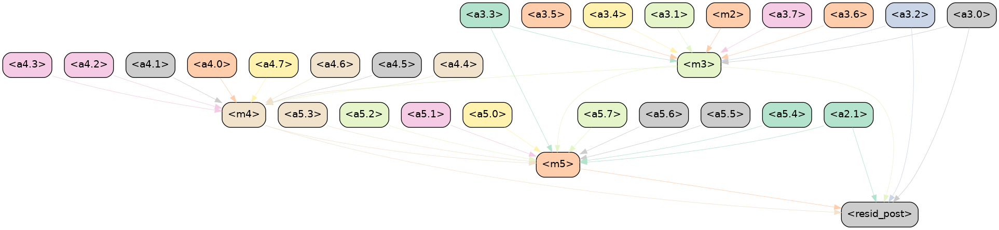

86 --------------------------------------------------
No edge 1570
1570
No edge 1570
New metric: 0.5421532988548279

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 7]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 7] is 0.5404472351074219 (and current metric 0.5421532988548279)
Result is -0.0017060637474060059...so removing connection
No edge 1569
We moved to  blocks.3.attn.hook_k[:, :, 6]
No edge 1569


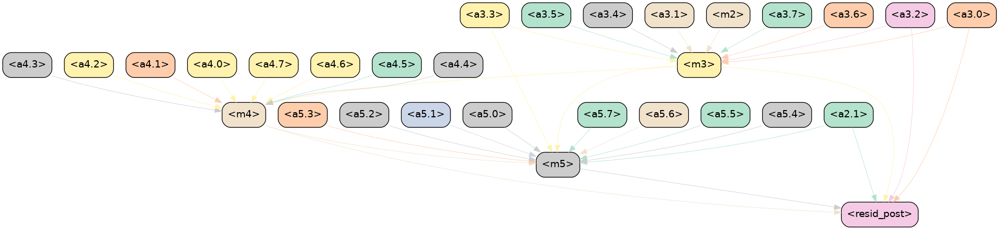

87 --------------------------------------------------
No edge 1569
1569
No edge 1569
New metric: 0.5404472351074219

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 6]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 6] is 0.5309255719184875 (and current metric 0.5404472351074219)
Result is -0.009521663188934326...so removing connection
No edge 1568
We moved to  blocks.3.attn.hook_k[:, :, 5]
No edge 1568


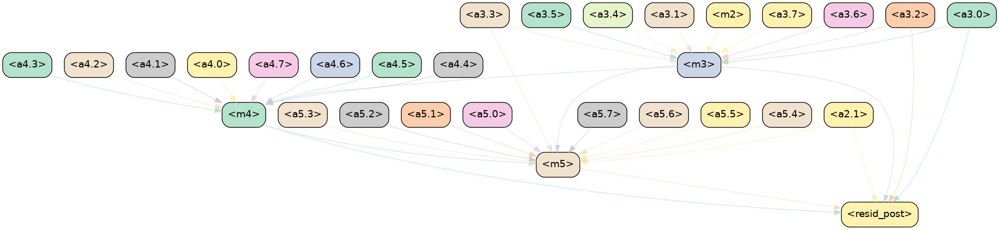

88 --------------------------------------------------
No edge 1568
1568
No edge 1568
New metric: 0.5309255719184875

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 5]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 5] is 0.5288363695144653 (and current metric 0.5309255719184875)
Result is -0.002089202404022217...so removing connection
No edge 1567
We moved to  blocks.3.attn.hook_k[:, :, 4]
No edge 1567


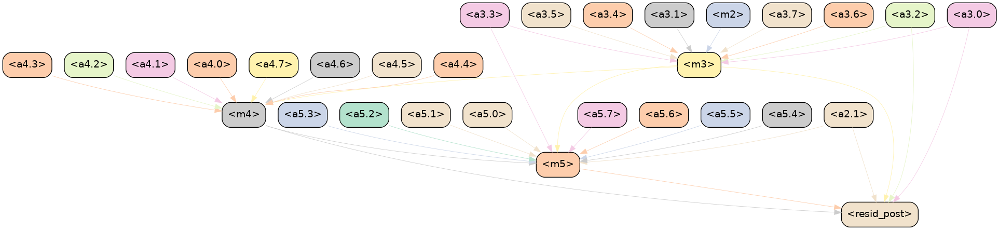

89 --------------------------------------------------
No edge 1567
1567
No edge 1567
New metric: 0.5288363695144653

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 4]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 4] is 0.5231887698173523 (and current metric 0.5288363695144653)
Result is -0.005647599697113037...so removing connection
No edge 1566
We moved to  blocks.3.attn.hook_k[:, :, 3]
No edge 1566


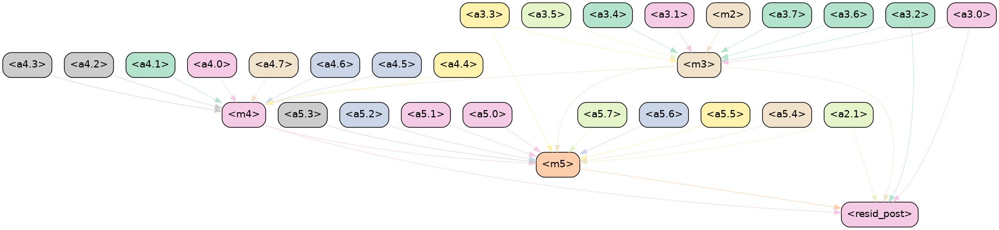

90 --------------------------------------------------
No edge 1566
1566
No edge 1566
New metric: 0.5231887698173523

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 3]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 3] is 0.5104963183403015 (and current metric 0.5231887698173523)
Result is -0.012692451477050781...so removing connection
No edge 1565
We moved to  blocks.3.attn.hook_k[:, :, 2]
No edge 1565


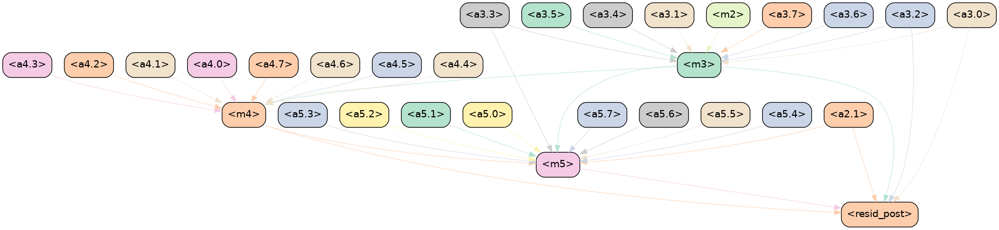

91 --------------------------------------------------
No edge 1565
1565
No edge 1565
New metric: 0.5104963183403015

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 2]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 2] is 0.509238064289093 (and current metric 0.5104963183403015)
Result is -0.001258254051208496...so removing connection
No edge 1564
We moved to  blocks.3.attn.hook_k[:, :, 1]
No edge 1564


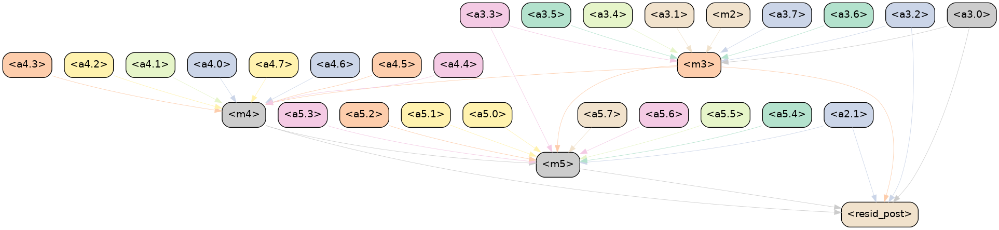

92 --------------------------------------------------
No edge 1564
1564
No edge 1564
New metric: 0.509238064289093

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 1]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 1] is 0.5021867752075195 (and current metric 0.509238064289093)
Result is -0.007051289081573486...so removing connection
No edge 1563
We moved to  blocks.3.attn.hook_k[:, :, 0]
No edge 1563


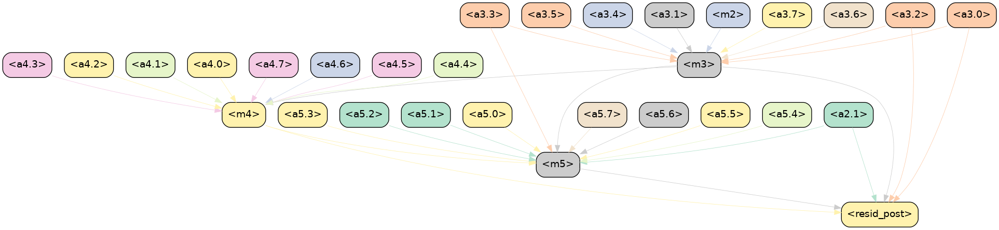

93 --------------------------------------------------
No edge 1563
1563
No edge 1563
New metric: 0.5021867752075195

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_k_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_k, [:, :, 0]))

Metric after removing connection to blocks.3.hook_k_input [:, :, 0] is 0.497570663690567 (and current metric 0.5021867752075195)
Result is -0.004616111516952515...so removing connection
No edge 1562
We moved to  blocks.3.attn.hook_q[:, :, 7]
No edge 1562


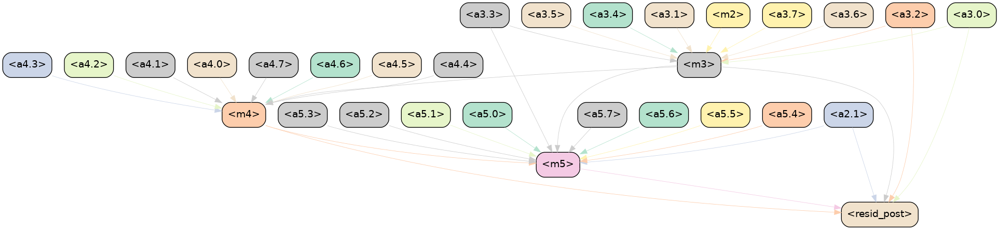

94 --------------------------------------------------
No edge 1562
1562
No edge 1562
New metric: 0.497570663690567

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 7]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 7] is 0.4942019283771515 (and current metric 0.497570663690567)
Result is -0.0033687353134155273...so removing connection
No edge 1561
We moved to  blocks.3.attn.hook_q[:, :, 6]
No edge 1561


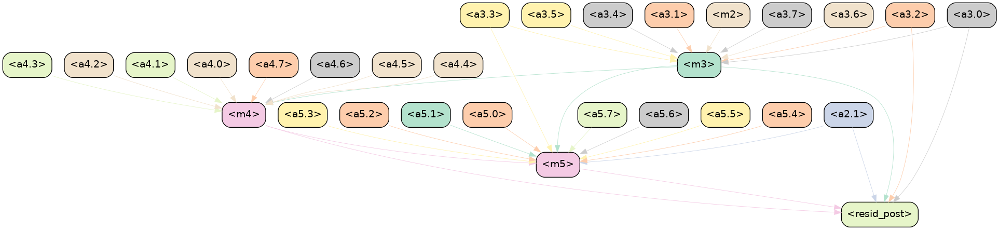

95 --------------------------------------------------
No edge 1561
1561
No edge 1561
New metric: 0.4942019283771515

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 6]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 6] is 0.4921543300151825 (and current metric 0.4942019283771515)
Result is -0.002047598361968994...so removing connection
No edge 1560
We moved to  blocks.3.attn.hook_q[:, :, 5]
No edge 1560


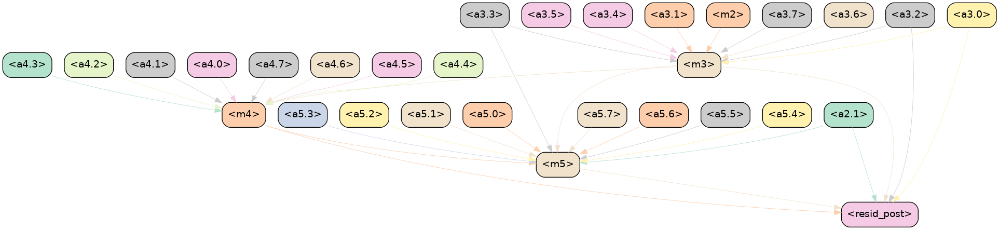

96 --------------------------------------------------
No edge 1560
1560
No edge 1560
New metric: 0.4921543300151825

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 5]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 5] is 0.48822420835494995 (and current metric 0.4921543300151825)
Result is -0.003930121660232544...so removing connection
No edge 1559
We moved to  blocks.3.attn.hook_q[:, :, 4]
No edge 1559


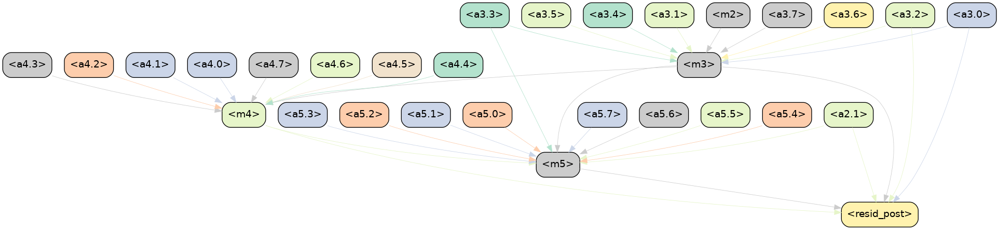

97 --------------------------------------------------
No edge 1559
1559
No edge 1559
New metric: 0.48822420835494995

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 4]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 4] is 0.4882591664791107 (and current metric 0.48822420835494995)
Result is 3.49581241607666e-05...so removing connection
No edge 1558
We moved to  blocks.3.attn.hook_q[:, :, 3]
No edge 1558


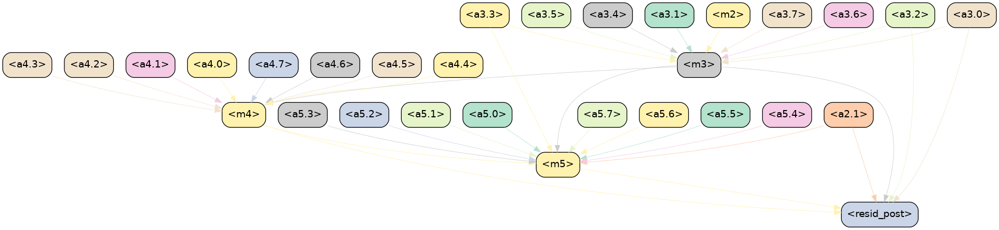

98 --------------------------------------------------
No edge 1558
1558
No edge 1558
New metric: 0.4882591664791107

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 3]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 3] is 0.49452659487724304 (and current metric 0.4882591664791107)
Result is 0.006267428398132324...so removing connection
No edge 1557
We moved to  blocks.3.attn.hook_q[:, :, 2]
No edge 1557


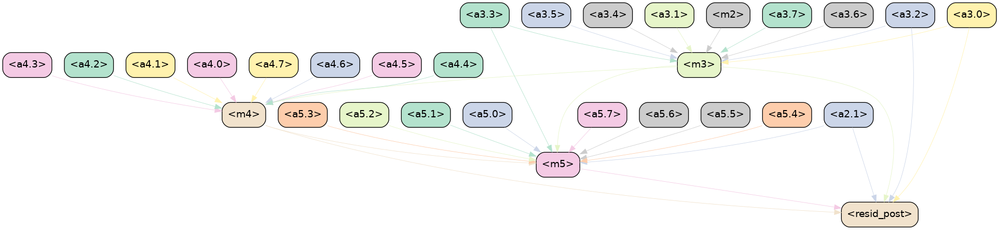

99 --------------------------------------------------
No edge 1557
1557
No edge 1557
New metric: 0.49452659487724304

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 2]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 2] is 0.49914297461509705 (and current metric 0.49452659487724304)
Result is 0.004616379737854004...so removing connection
No edge 1556
We moved to  blocks.3.attn.hook_q[:, :, 1]
No edge 1556


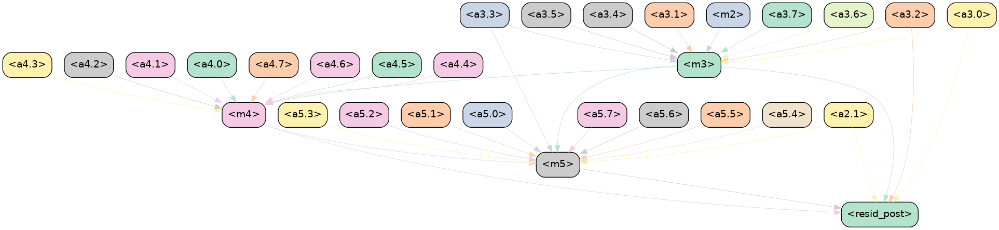

100 --------------------------------------------------
No edge 1556
1556
No edge 1556
New metric: 0.49914297461509705

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 1]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 1] is 0.4968402087688446 (and current metric 0.49914297461509705)
Result is -0.0023027658462524414...so removing connection
No edge 1555
We moved to  blocks.3.attn.hook_q[:, :, 0]
No edge 1555


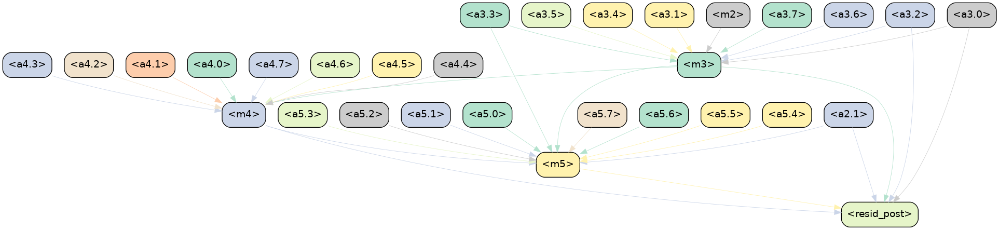

101 --------------------------------------------------
No edge 1555
1555
No edge 1555
New metric: 0.4968402087688446

Node: cur_parent=TLACDCInterpNode(blocks.3.hook_q_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.3.attn.hook_q, [:, :, 0]))

Metric after removing connection to blocks.3.hook_q_input [:, :, 0] is 0.4981703460216522 (and current metric 0.4968402087688446)
Result is 0.0013301372528076172...so removing connection
No edge 1554
We moved to  blocks.3.hook_v_input[:, :, 7]
No edge 1554
No edge 1526
But it's bad
We moved to  blocks.3.hook_v_input[:, :, 6]
No edge 1526
No edge 1498
But it's bad
We moved to  blocks.3.hook_v_input[:, :, 5]
No edge 1498
No edge 1470
But it's bad
We moved to  blocks.3.hook_v_input[:, :, 4]
No edge 1470
No edge 1442
But it's bad
We moved to  blocks.3.hook_v_input[:, :, 3]
No edge 1442
No edge 1414
But it's bad
We moved to  blocks.3.hook_v_input[:, :, 2]
No edge 1414
No edge 1386
But it's bad
We moved to  blocks.3.hook_v_input[:, :, 1]
N

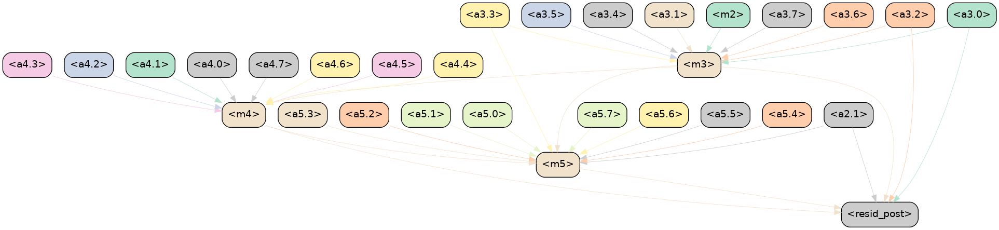

102 --------------------------------------------------
No edge 882
882
No edge 882
New metric: 0.4981703460216522
No edge 882
We moved to  blocks.2.hook_mlp_in[:]
No edge 882


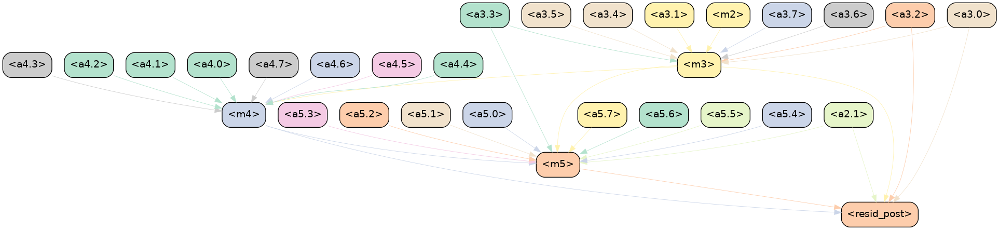

103 --------------------------------------------------
No edge 882
882
No edge 882
New metric: 0.4981703460216522

Node: cur_parent=TLACDCInterpNode(blocks.2.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.2.hook_mlp_in, [:]))

Metric after removing connection to blocks.2.attn.hook_result [:, :, 7] is 0.5745859146118164 (and current metric 0.4981703460216522)
Result is 0.07641556859016418...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.2.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.2.hook_mlp_in, [:]))

Metric after removing connection to blocks.2.attn.hook_result [:, :, 6] is 0.5762883424758911 (and current metric 0.4981703460216522)
Result is 0.07811799645423889...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.2.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.2.hook_mlp_in, [:]))

Metric after removing connection to blocks.2.attn.hook_result [:, :, 5] is 0.5772255063056946 (a

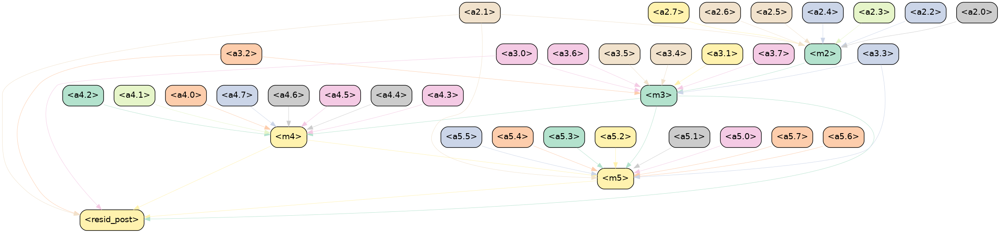

104 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 6]
No edge 863


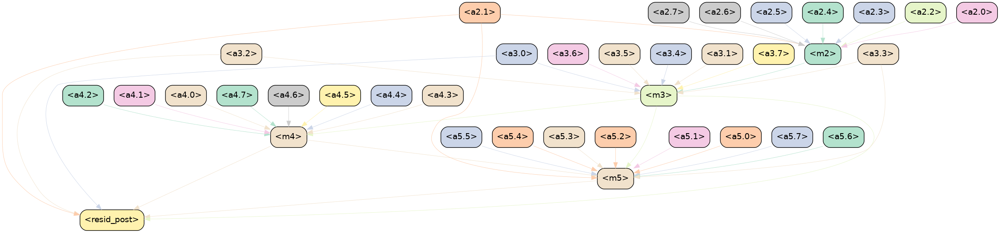

105 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 5]
No edge 863


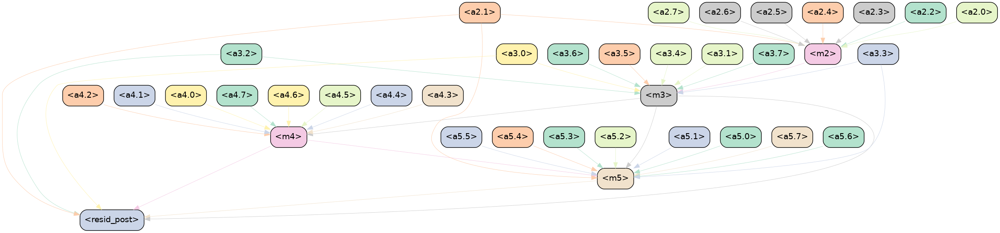

106 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 4]
No edge 863


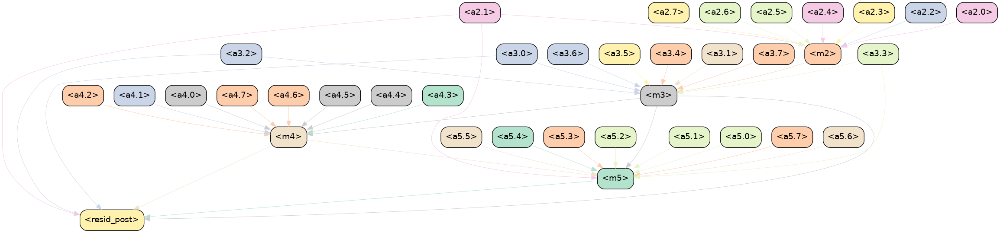

107 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 3]
No edge 863


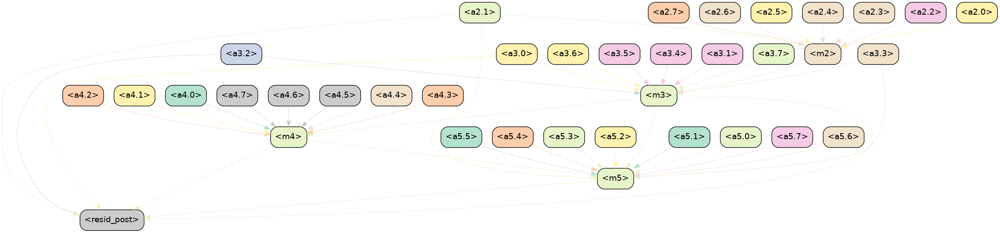

108 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 2]
No edge 863


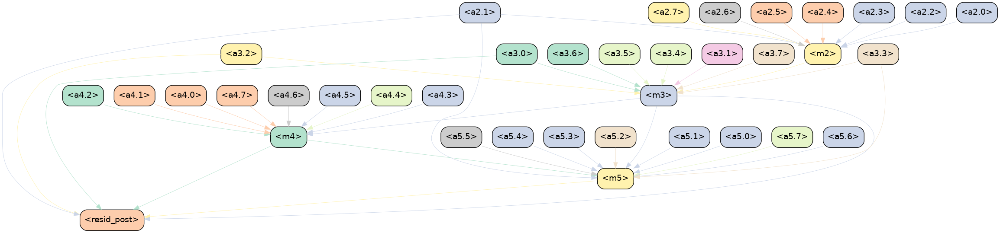

109 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 1]
No edge 863


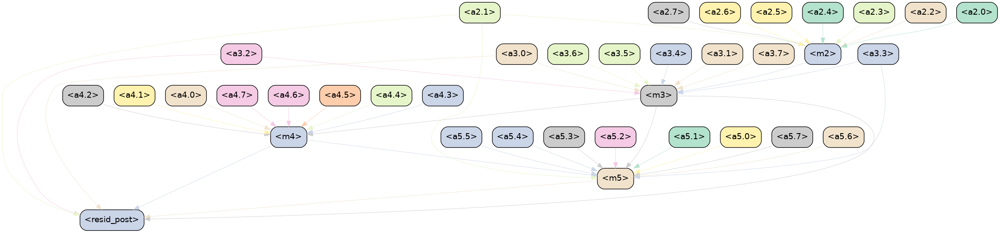

110 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_result[:, :, 0]
No edge 863


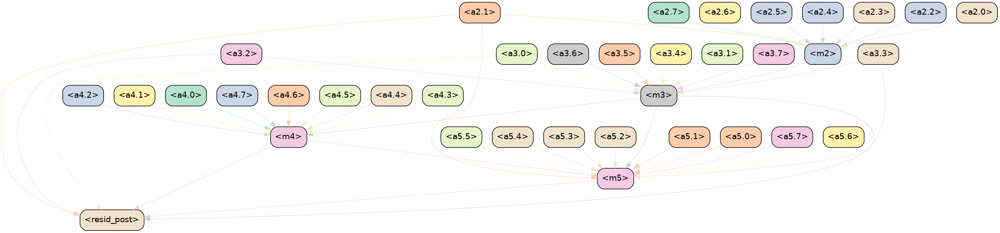

111 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141
No edge 863
No edge 863
No edge 863
We moved to  blocks.2.attn.hook_v[:, :, 7]
No edge 863


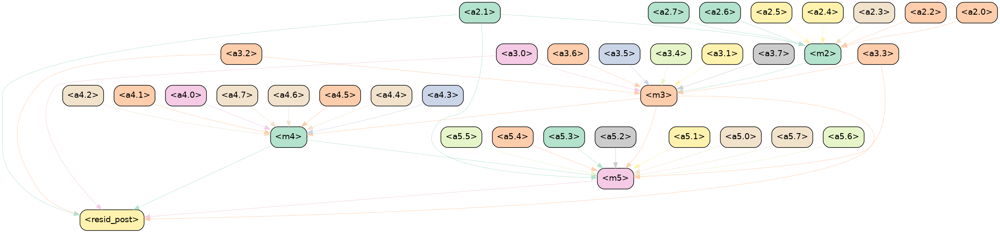

112 --------------------------------------------------
No edge 863
863
No edge 863
New metric: 0.5449924468994141

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 7]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 7] is 0.5440003275871277 (and current metric 0.5449924468994141)
Result is -0.000992119312286377...so removing connection
No edge 862
We moved to  blocks.2.attn.hook_v[:, :, 6]
No edge 862


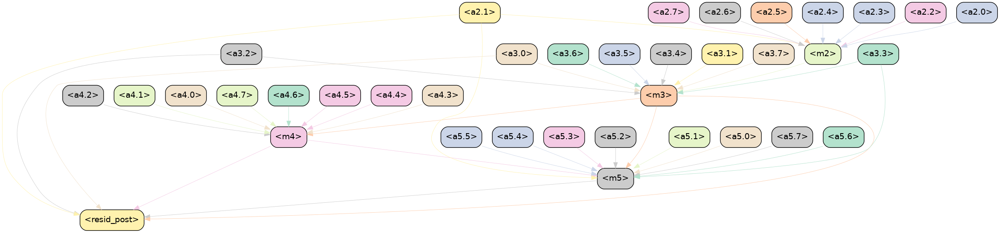

113 --------------------------------------------------
No edge 862
862
No edge 862
New metric: 0.5440003275871277

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 6]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 6] is 0.5411834120750427 (and current metric 0.5440003275871277)
Result is -0.002816915512084961...so removing connection
No edge 861
We moved to  blocks.2.attn.hook_v[:, :, 5]
No edge 861


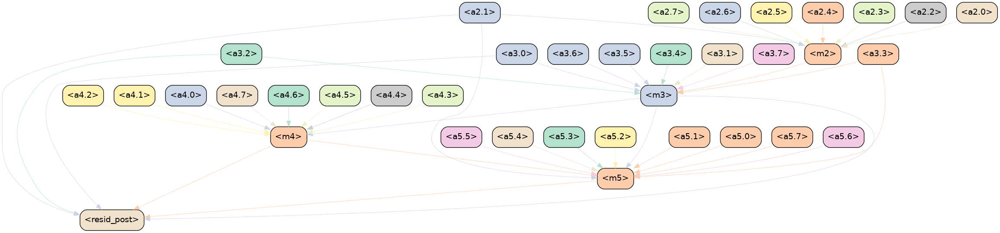

114 --------------------------------------------------
No edge 861
861
No edge 861
New metric: 0.5411834120750427

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 5]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 5] is 0.5440528988838196 (and current metric 0.5411834120750427)
Result is 0.0028694868087768555...so removing connection
No edge 860
We moved to  blocks.2.attn.hook_v[:, :, 4]
No edge 860


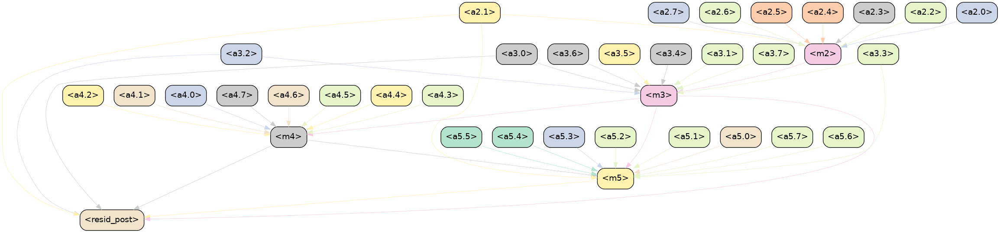

115 --------------------------------------------------
No edge 860
860
No edge 860
New metric: 0.5440528988838196

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 4]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 4] is 0.5443325042724609 (and current metric 0.5440528988838196)
Result is 0.0002796053886413574...so removing connection
No edge 859
We moved to  blocks.2.attn.hook_v[:, :, 3]
No edge 859


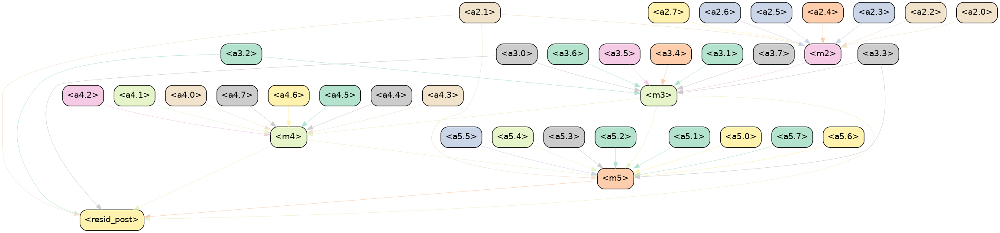

116 --------------------------------------------------
No edge 859
859
No edge 859
New metric: 0.5443325042724609

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 3]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 3] is 0.5363518595695496 (and current metric 0.5443325042724609)
Result is -0.007980644702911377...so removing connection
No edge 858
We moved to  blocks.2.attn.hook_v[:, :, 2]
No edge 858


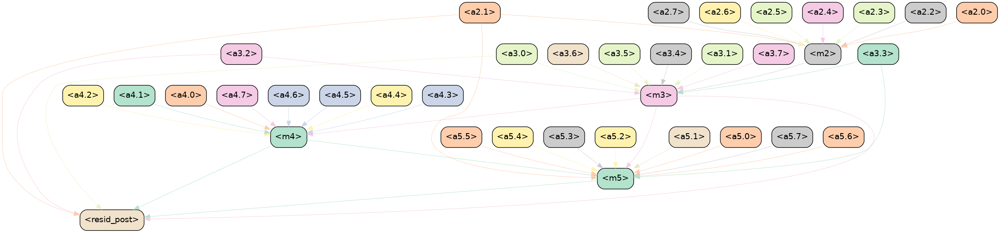

117 --------------------------------------------------
No edge 858
858
No edge 858
New metric: 0.5363518595695496

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 2]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 2] is 0.5415608286857605 (and current metric 0.5363518595695496)
Result is 0.0052089691162109375...so removing connection
No edge 857
We moved to  blocks.2.attn.hook_v[:, :, 1]
No edge 857


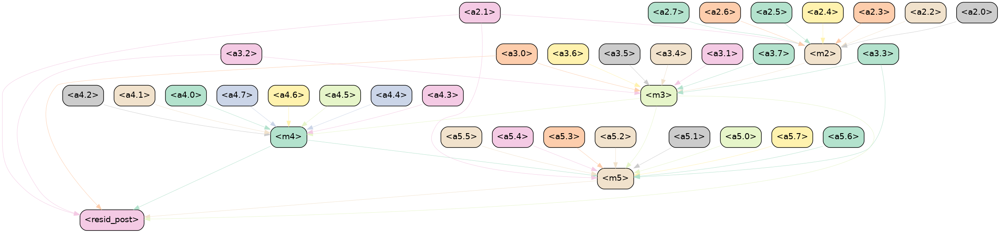

118 --------------------------------------------------
No edge 857
857
No edge 857
New metric: 0.5415608286857605

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 1]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 1] is 0.5013478398323059 (and current metric 0.5415608286857605)
Result is -0.04021298885345459...so removing connection
No edge 856
We moved to  blocks.2.attn.hook_v[:, :, 0]
No edge 856


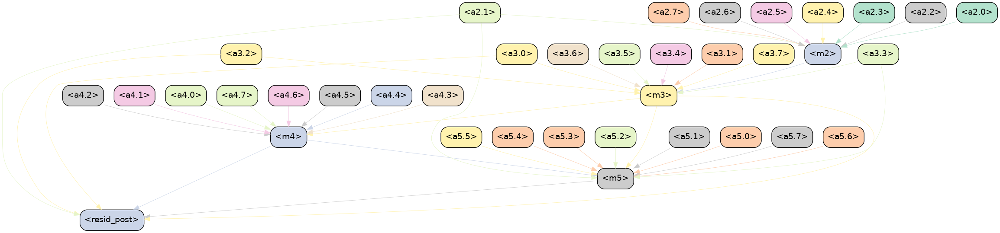

119 --------------------------------------------------
No edge 856
856
No edge 856
New metric: 0.5013478398323059

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_v_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_v, [:, :, 0]))

Metric after removing connection to blocks.2.hook_v_input [:, :, 0] is 0.49260836839675903 (and current metric 0.5013478398323059)
Result is -0.008739471435546875...so removing connection
No edge 855
We moved to  blocks.2.attn.hook_k[:, :, 7]
No edge 855


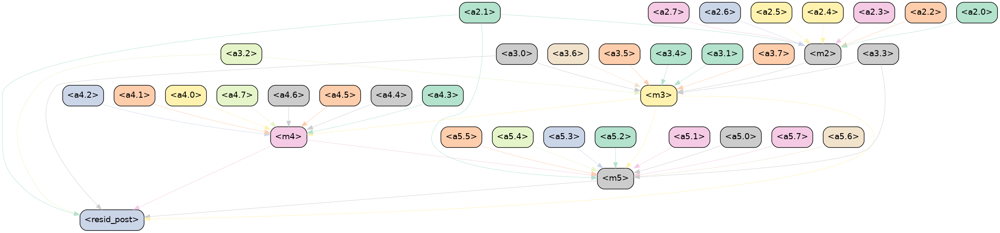

120 --------------------------------------------------
No edge 855
855
No edge 855
New metric: 0.49260836839675903

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 7]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 7] is 0.49225765466690063 (and current metric 0.49260836839675903)
Result is -0.00035071372985839844...so removing connection
No edge 854
We moved to  blocks.2.attn.hook_k[:, :, 6]
No edge 854


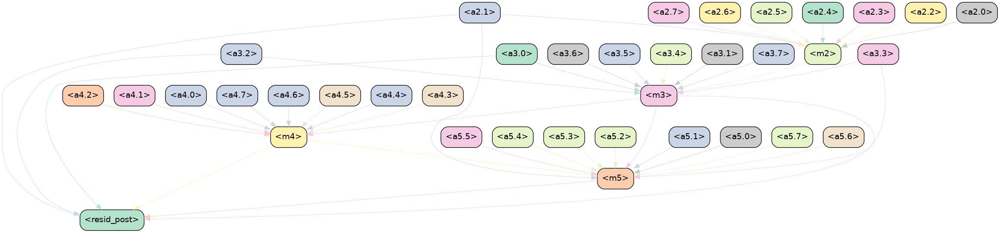

121 --------------------------------------------------
No edge 854
854
No edge 854
New metric: 0.49225765466690063

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 6]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 6] is 0.4956558644771576 (and current metric 0.49225765466690063)
Result is 0.003398209810256958...so removing connection
No edge 853
We moved to  blocks.2.attn.hook_k[:, :, 5]
No edge 853


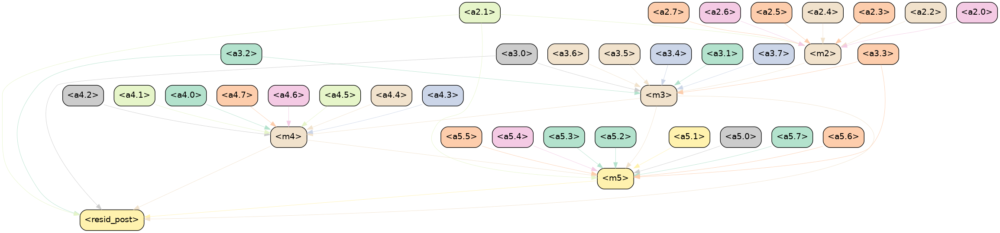

122 --------------------------------------------------
No edge 853
853
No edge 853
New metric: 0.4956558644771576

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 5]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 5] is 0.4993855059146881 (and current metric 0.4956558644771576)
Result is 0.0037296414375305176...so removing connection
No edge 852
We moved to  blocks.2.attn.hook_k[:, :, 4]
No edge 852


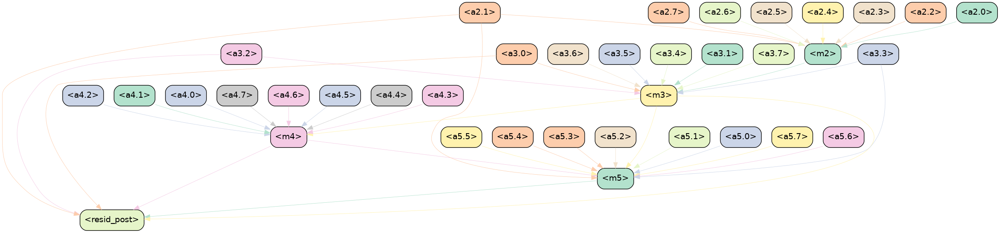

123 --------------------------------------------------
No edge 852
852
No edge 852
New metric: 0.4993855059146881

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 4]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 4] is 0.5034839510917664 (and current metric 0.4993855059146881)
Result is 0.004098445177078247...so removing connection
No edge 851
We moved to  blocks.2.attn.hook_k[:, :, 3]
No edge 851


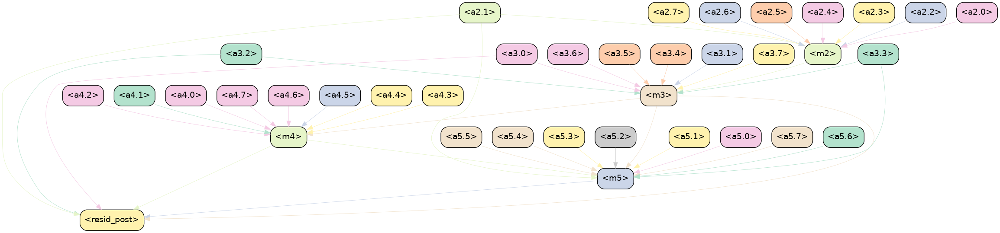

124 --------------------------------------------------
No edge 851
851
No edge 851
New metric: 0.5034839510917664

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 3]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 3] is 0.5069392919540405 (and current metric 0.5034839510917664)
Result is 0.00345534086227417...so removing connection
No edge 850
We moved to  blocks.2.attn.hook_k[:, :, 2]
No edge 850


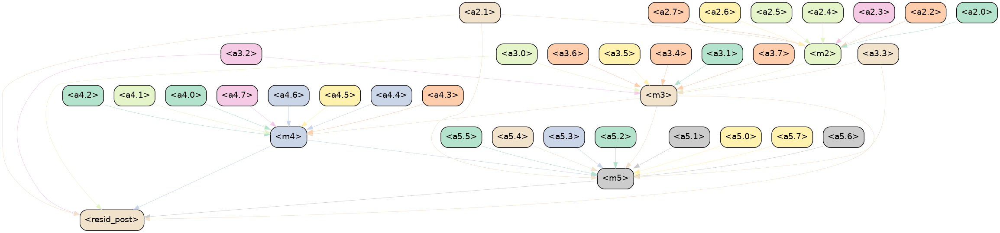

125 --------------------------------------------------
No edge 850
850
No edge 850
New metric: 0.5069392919540405

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 2]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 2] is 0.5065917372703552 (and current metric 0.5069392919540405)
Result is -0.00034755468368530273...so removing connection
No edge 849
We moved to  blocks.2.attn.hook_k[:, :, 1]
No edge 849


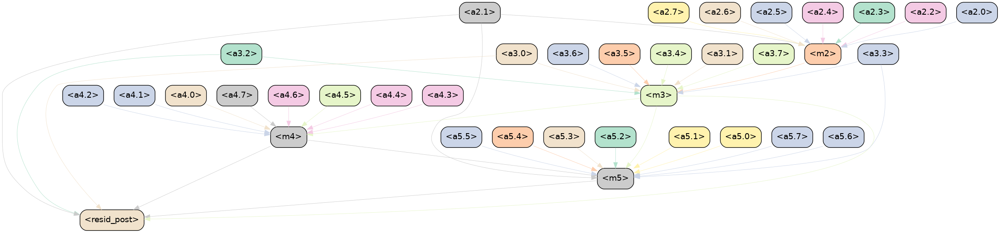

126 --------------------------------------------------
No edge 849
849
No edge 849
New metric: 0.5065917372703552

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 1]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 1] is 0.5044044852256775 (and current metric 0.5065917372703552)
Result is -0.0021872520446777344...so removing connection
No edge 848
We moved to  blocks.2.attn.hook_k[:, :, 0]
No edge 848


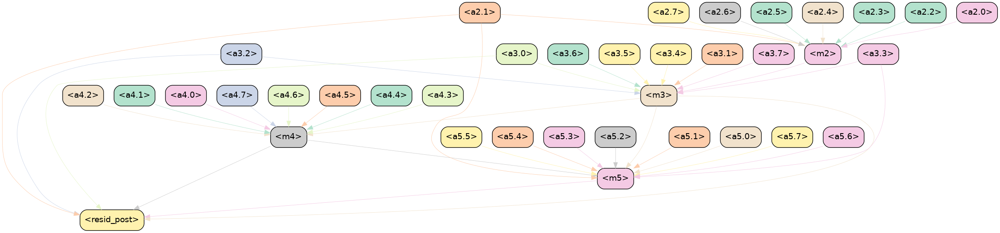

127 --------------------------------------------------
No edge 848
848
No edge 848
New metric: 0.5044044852256775

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_k_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_k, [:, :, 0]))

Metric after removing connection to blocks.2.hook_k_input [:, :, 0] is 0.5031712055206299 (and current metric 0.5044044852256775)
Result is -0.0012332797050476074...so removing connection
No edge 847
We moved to  blocks.2.attn.hook_q[:, :, 7]
No edge 847


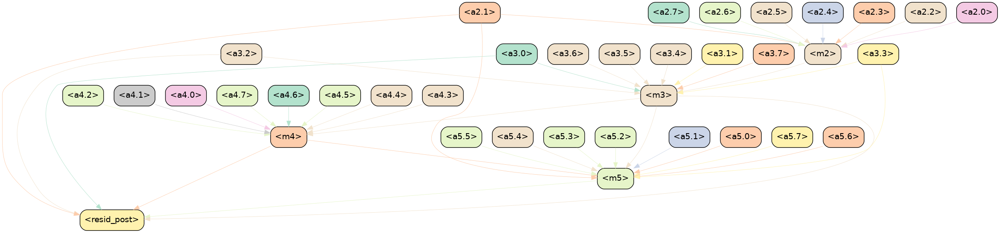

128 --------------------------------------------------
No edge 847
847
No edge 847
New metric: 0.5031712055206299

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 7]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 7] is 0.5029639601707458 (and current metric 0.5031712055206299)
Result is -0.0002072453498840332...so removing connection
No edge 846
We moved to  blocks.2.attn.hook_q[:, :, 6]
No edge 846


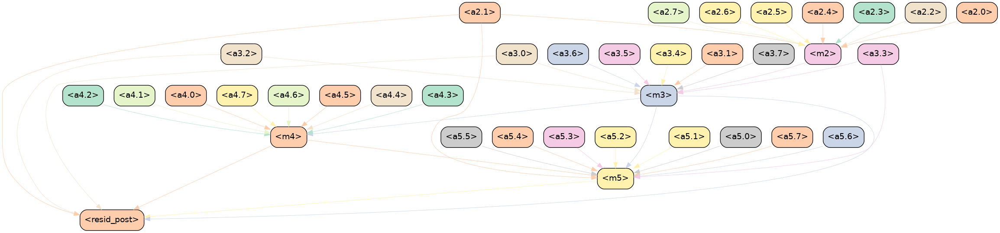

129 --------------------------------------------------
No edge 846
846
No edge 846
New metric: 0.5029639601707458

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 6]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 6] is 0.49956202507019043 (and current metric 0.5029639601707458)
Result is -0.00340193510055542...so removing connection
No edge 845
We moved to  blocks.2.attn.hook_q[:, :, 5]
No edge 845


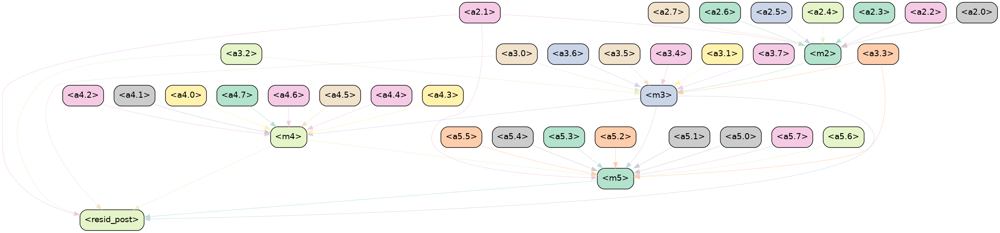

130 --------------------------------------------------
No edge 845
845
No edge 845
New metric: 0.49956202507019043

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 5]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 5] is 0.4949459731578827 (and current metric 0.49956202507019043)
Result is -0.004616051912307739...so removing connection
No edge 844
We moved to  blocks.2.attn.hook_q[:, :, 4]
No edge 844


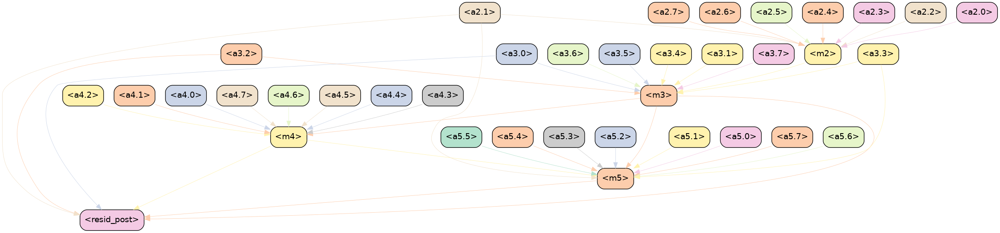

131 --------------------------------------------------
No edge 844
844
No edge 844
New metric: 0.4949459731578827

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 4]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 4]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 4] is 0.49765974283218384 (and current metric 0.4949459731578827)
Result is 0.0027137696743011475...so removing connection
No edge 843
We moved to  blocks.2.attn.hook_q[:, :, 3]
No edge 843


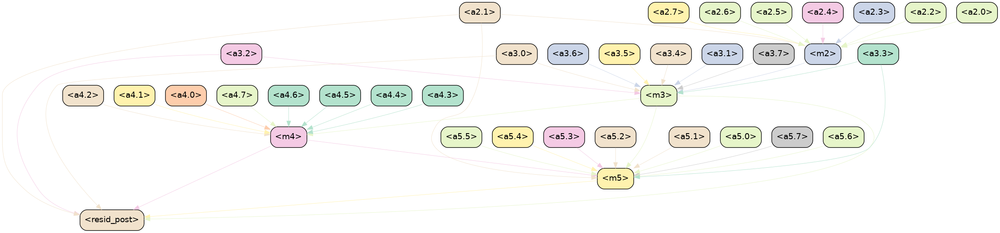

132 --------------------------------------------------
No edge 843
843
No edge 843
New metric: 0.49765974283218384

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 3]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 3]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 3] is 0.49596017599105835 (and current metric 0.49765974283218384)
Result is -0.0016995668411254883...so removing connection
No edge 842
We moved to  blocks.2.attn.hook_q[:, :, 2]
No edge 842


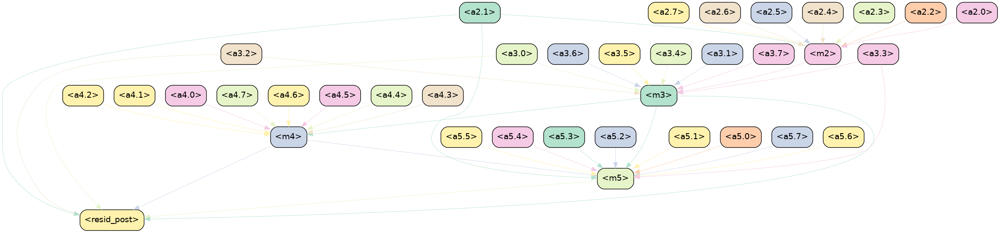

133 --------------------------------------------------
No edge 842
842
No edge 842
New metric: 0.49596017599105835

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 2]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 2]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 2] is 0.4936167001724243 (and current metric 0.49596017599105835)
Result is -0.002343475818634033...so removing connection
No edge 841
We moved to  blocks.2.attn.hook_q[:, :, 1]
No edge 841


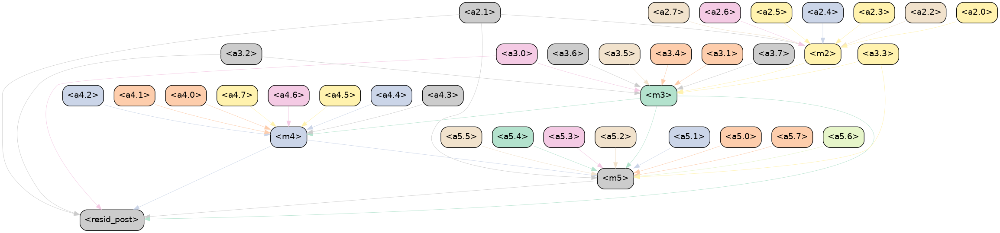

134 --------------------------------------------------
No edge 841
841
No edge 841
New metric: 0.4936167001724243

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 1]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 1]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 1] is 0.4916842579841614 (and current metric 0.4936167001724243)
Result is -0.0019324421882629395...so removing connection
No edge 840
We moved to  blocks.2.attn.hook_q[:, :, 0]
No edge 840


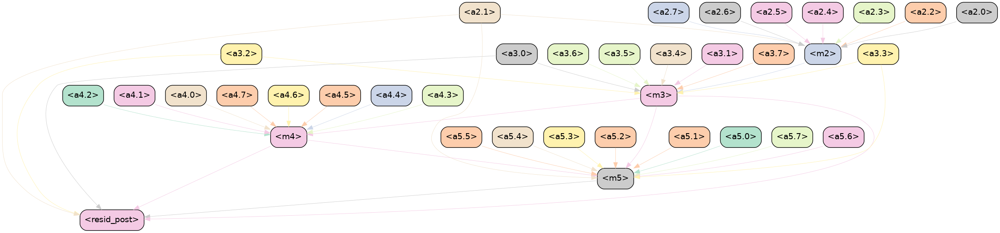

135 --------------------------------------------------
No edge 840
840
No edge 840
New metric: 0.4916842579841614

Node: cur_parent=TLACDCInterpNode(blocks.2.hook_q_input, [:, :, 0]) (self.current_node=TLACDCInterpNode(blocks.2.attn.hook_q, [:, :, 0]))

Metric after removing connection to blocks.2.hook_q_input [:, :, 0] is 0.49201858043670654 (and current metric 0.4916842579841614)
Result is 0.000334322452545166...so removing connection
No edge 839
We moved to  blocks.2.hook_v_input[:, :, 7]
No edge 839
No edge 820
But it's bad
We moved to  blocks.2.hook_v_input[:, :, 6]
No edge 820
No edge 801
But it's bad
We moved to  blocks.2.hook_v_input[:, :, 5]
No edge 801
No edge 782
But it's bad
We moved to  blocks.2.hook_v_input[:, :, 4]
No edge 782
No edge 763
But it's bad
We moved to  blocks.2.hook_v_input[:, :, 3]
No edge 763
No edge 744
But it's bad
We moved to  blocks.2.hook_v_input[:, :, 2]
No edge 744
No edge 725
But it's bad
We moved to  blocks.2.hook_v_input[:, :, 1]
No edge 725
No ed

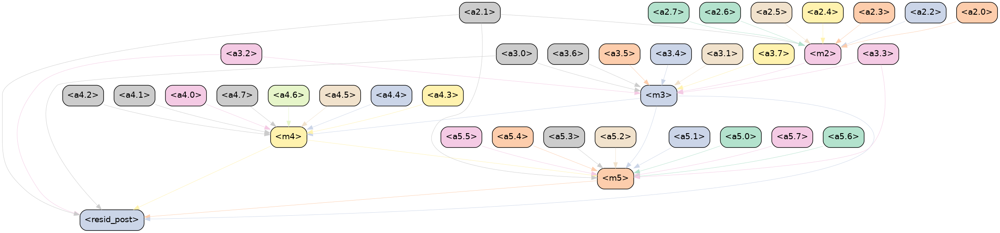

136 --------------------------------------------------
No edge 44
44
No edge 44
New metric: 0.49201858043670654
We moved to  None
No edge 44


/workspace/Automatic-Circuit-Discovery/acdc/TLACDCExperiment.py:772: UserWarning:

Finished iterating



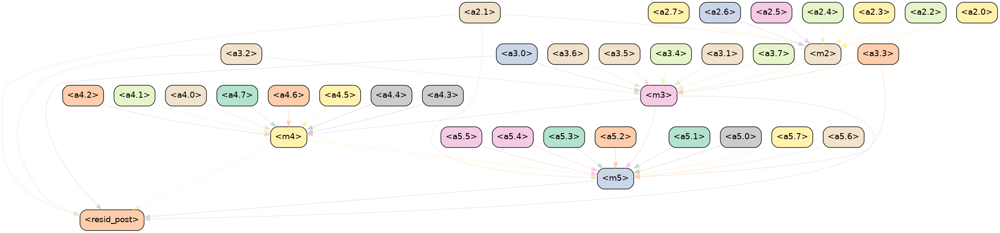

137 --------------------------------------------------
No edge 44
44


In [15]:
for i in range(args.max_num_epochs):
    exp.step(testing=False)

    show(
        exp.corr,
        f"ims/img_new_{i+1}.png",
        show_full_index=False,
    )

    if IN_COLAB or ipython is not None:
        # so long as we're not running this as a script, show the image!
        display(Image(f"ims/img_new_{i+1}.png"))

    print(i, "-" * 50)
    print(exp.count_no_edges())

    if i == 0:
        exp.save_edges("edges.pkl")

    if exp.current_node is None or SINGLE_STEP:
        break

exp.save_edges("another_final_edges.pkl")

if USING_WANDB:
    edges_fname = f"edges.pth"
    exp.save_edges(edges_fname)
    artifact = wandb.Artifact(edges_fname, type="dataset")
    artifact.add_file(edges_fname)
    wandb.log_artifact(artifact)
    os.remove(edges_fname)
    wandb.finish()

No edge 3772
New metric: 9.892860930449388e-08

Node: cur_parent=TLACDCInterpNode(blocks.5.hook_mlp_out, [:]) (self.current_node=TLACDCInterpNode(blocks.5.hook_resid_post, [:]))

Metric after removing connection to blocks.5.hook_mlp_out [:] is 0.15827840566635132 (and current metric 9.892860930449388e-08)
Result is 0.158278306737742...so keeping connection
No edge 3772

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.hook_resid_post, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 7] is 0.003492324613034725 (and current metric 1.2278577798952028e-07)
Result is 0.0034922018272567357...so removing connection

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.hook_resid_post, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 6] is 0.0034928068052977324 (and current metric 0.003492324613034725)
Result i

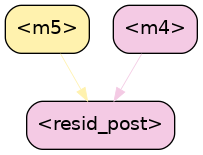

0 --------------------------------------------------
No edge 3719
3719
No edge 3719
New metric: 0.24682551622390747
No edge 3719
We moved to  blocks.5.hook_mlp_in[:]
No edge 3719


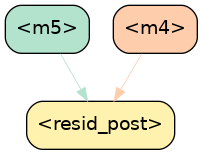

1 --------------------------------------------------
No edge 3719
3719
No edge 3719
New metric: 0.24682551622390747

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.5.hook_mlp_in, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 7] is 0.29879051446914673 (and current metric 0.24682551622390747)
Result is 0.05196499824523926...so removing connection

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.5.hook_mlp_in, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 6] is 0.2985759973526001 (and current metric 0.29879051446914673)
Result is -0.00021451711654663086...so removing connection

Node: cur_parent=TLACDCInterpNode(blocks.5.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.5.hook_mlp_in, [:]))

Metric after removing connection to blocks.5.attn.hook_result [:, :, 5] is 0.29516398

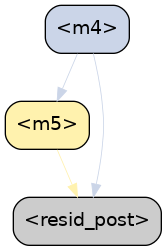

2 --------------------------------------------------
No edge 2538
2538
No edge 2538
New metric: 0.42142432928085327
No edge 2538
We moved to  blocks.4.hook_mlp_in[:]
No edge 2538


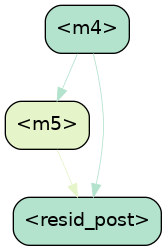

3 --------------------------------------------------
No edge 2538
2538
No edge 2538
New metric: 0.42142432928085327

Node: cur_parent=TLACDCInterpNode(blocks.4.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.hook_mlp_in, [:]))

Metric after removing connection to blocks.4.attn.hook_result [:, :, 7] is 0.4933200478553772 (and current metric 0.42142432928085327)
Result is 0.07189571857452393...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.4.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.hook_mlp_in, [:]))

Metric after removing connection to blocks.4.attn.hook_result [:, :, 6] is 0.48655226826667786 (and current metric 0.42142432928085327)
Result is 0.06512793898582458...so keeping connection

Node: cur_parent=TLACDCInterpNode(blocks.4.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.4.hook_mlp_in, [:]))

Metric after removing connection to blocks.4.attn.hook_result [:, :, 5] is 0.46473219990730

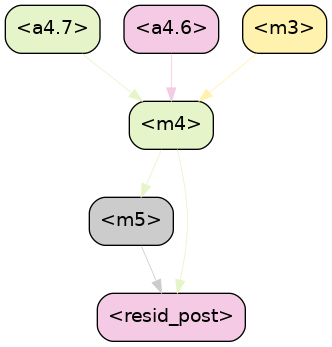

4 --------------------------------------------------
No edge 2496
2496
No edge 2496
New metric: 0.5275382995605469
No edge 2496
No edge 2496
No edge 2496
We moved to  blocks.4.attn.hook_result[:, :, 6]
No edge 2496


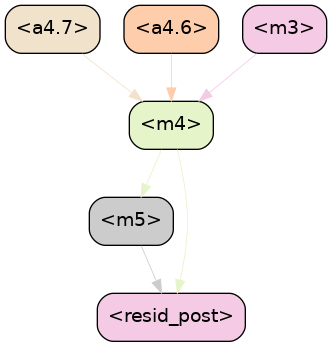

5 --------------------------------------------------
No edge 2496
2496
No edge 2496
New metric: 0.5275382995605469
No edge 2496
No edge 2496
No edge 2496
We moved to  blocks.4.attn.hook_result[:, :, 5]
No edge 2496
No edge 2496
But it's bad
We moved to  blocks.4.attn.hook_result[:, :, 4]
No edge 2496
No edge 2496
But it's bad
We moved to  blocks.4.attn.hook_result[:, :, 3]
No edge 2496
No edge 2496
But it's bad
We moved to  blocks.4.attn.hook_result[:, :, 2]
No edge 2496
No edge 2496
But it's bad
We moved to  blocks.4.attn.hook_result[:, :, 1]
No edge 2496
No edge 2496
But it's bad
We moved to  blocks.4.attn.hook_result[:, :, 0]
No edge 2496
No edge 2496
But it's bad
We moved to  blocks.4.attn.hook_v[:, :, 7]
No edge 2496


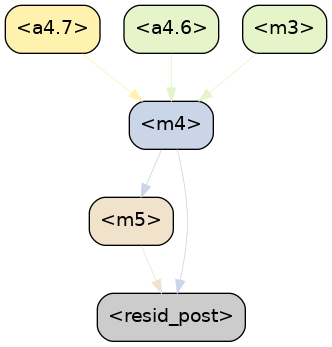

6 --------------------------------------------------
No edge 2496
2496
No edge 2496
New metric: 0.5275382995605469

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 7]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 7] is 0.5290780067443848 (and current metric 0.5275382995605469)
Result is 0.0015397071838378906...so removing connection
No edge 2495
We moved to  blocks.4.attn.hook_v[:, :, 6]
No edge 2495


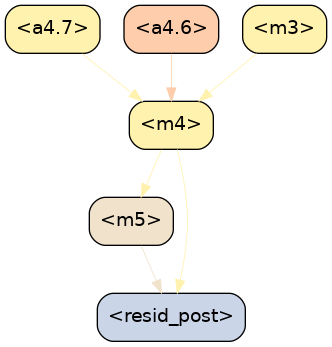

7 --------------------------------------------------
No edge 2495
2495
No edge 2495
New metric: 0.5290780067443848

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_v_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_v, [:, :, 6]))

Metric after removing connection to blocks.4.hook_v_input [:, :, 6] is 0.5309839844703674 (and current metric 0.5290780067443848)
Result is 0.001905977725982666...so removing connection
No edge 2494
We moved to  blocks.4.attn.hook_v[:, :, 5]
No edge 2494
No edge 2493
But it's bad
We moved to  blocks.4.attn.hook_v[:, :, 4]
No edge 2493
No edge 2492
But it's bad
We moved to  blocks.4.attn.hook_v[:, :, 3]
No edge 2492
No edge 2491
But it's bad
We moved to  blocks.4.attn.hook_v[:, :, 2]
No edge 2491
No edge 2490
But it's bad
We moved to  blocks.4.attn.hook_v[:, :, 1]
No edge 2490
No edge 2489
But it's bad
We moved to  blocks.4.attn.hook_v[:, :, 0]
No edge 2489
No edge 2488
But it's bad
We moved to  blocks.4.attn.hook_k[:, :, 7]
No edge 248

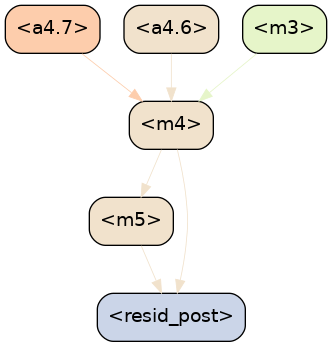

8 --------------------------------------------------
No edge 2488
2488
No edge 2488
New metric: 0.5309839844703674

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 7]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 7] is 0.5369740724563599 (and current metric 0.5309839844703674)
Result is 0.005990087985992432...so removing connection
No edge 2487
We moved to  blocks.4.attn.hook_k[:, :, 6]
No edge 2487


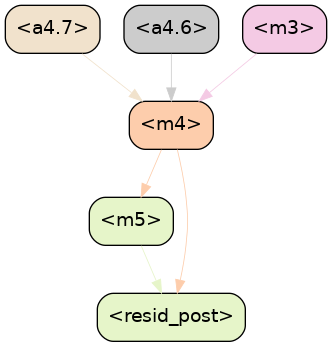

9 --------------------------------------------------
No edge 2487
2487
No edge 2487
New metric: 0.5369740724563599

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_k_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_k, [:, :, 6]))

Metric after removing connection to blocks.4.hook_k_input [:, :, 6] is 0.5317109227180481 (and current metric 0.5369740724563599)
Result is -0.005263149738311768...so removing connection
No edge 2486
We moved to  blocks.4.attn.hook_k[:, :, 5]
No edge 2486
No edge 2485
But it's bad
We moved to  blocks.4.attn.hook_k[:, :, 4]
No edge 2485
No edge 2484
But it's bad
We moved to  blocks.4.attn.hook_k[:, :, 3]
No edge 2484
No edge 2483
But it's bad
We moved to  blocks.4.attn.hook_k[:, :, 2]
No edge 2483
No edge 2482
But it's bad
We moved to  blocks.4.attn.hook_k[:, :, 1]
No edge 2482
No edge 2481
But it's bad
We moved to  blocks.4.attn.hook_k[:, :, 0]
No edge 2481
No edge 2480
But it's bad
We moved to  blocks.4.attn.hook_q[:, :, 7]
No edge 24

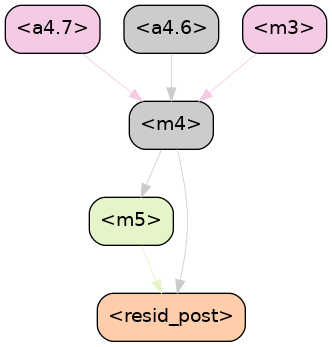

10 --------------------------------------------------
No edge 2480
2480
No edge 2480
New metric: 0.5317109227180481

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 7]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 7] is 0.5290961265563965 (and current metric 0.5317109227180481)
Result is -0.0026147961616516113...so removing connection
No edge 2479
We moved to  blocks.4.attn.hook_q[:, :, 6]
No edge 2479


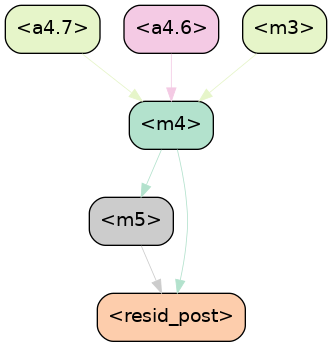

11 --------------------------------------------------
No edge 2479
2479
No edge 2479
New metric: 0.5290961265563965

Node: cur_parent=TLACDCInterpNode(blocks.4.hook_q_input, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.4.attn.hook_q, [:, :, 6]))

Metric after removing connection to blocks.4.hook_q_input [:, :, 6] is 0.529726505279541 (and current metric 0.5290961265563965)
Result is 0.0006303787231445312...so removing connection
No edge 2478
We moved to  blocks.4.attn.hook_q[:, :, 5]
No edge 2478
No edge 2477
But it's bad
We moved to  blocks.4.attn.hook_q[:, :, 4]
No edge 2477
No edge 2476
But it's bad
We moved to  blocks.4.attn.hook_q[:, :, 3]
No edge 2476
No edge 2475
But it's bad
We moved to  blocks.4.attn.hook_q[:, :, 2]
No edge 2475
No edge 2474
But it's bad
We moved to  blocks.4.attn.hook_q[:, :, 1]
No edge 2474
No edge 2473
But it's bad
We moved to  blocks.4.attn.hook_q[:, :, 0]
No edge 2473
No edge 2472
But it's bad
We moved to  blocks.4.hook_v_input[:, :, 7]
No edge 2

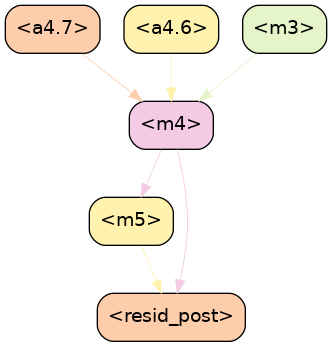

12 --------------------------------------------------
No edge 1584
1584
No edge 1584
New metric: 0.529726505279541
No edge 1584
We moved to  blocks.3.hook_mlp_in[:]
No edge 1584


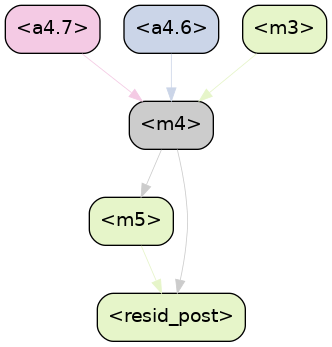

13 --------------------------------------------------
No edge 1584
1584
No edge 1584
New metric: 0.529726505279541

Node: cur_parent=TLACDCInterpNode(blocks.3.attn.hook_result, [:, :, 7]) (self.current_node=TLACDCInterpNode(blocks.3.hook_mlp_in, [:]))

Metric after removing connection to blocks.3.attn.hook_result [:, :, 7] is 0.5606451034545898 (and current metric 0.529726505279541)
Result is 0.030918598175048828...so removing connection

Node: cur_parent=TLACDCInterpNode(blocks.3.attn.hook_result, [:, :, 6]) (self.current_node=TLACDCInterpNode(blocks.3.hook_mlp_in, [:]))

Metric after removing connection to blocks.3.attn.hook_result [:, :, 6] is 0.564752995967865 (and current metric 0.5606451034545898)
Result is 0.0041078925132751465...so removing connection

Node: cur_parent=TLACDCInterpNode(blocks.3.attn.hook_result, [:, :, 5]) (self.current_node=TLACDCInterpNode(blocks.3.hook_mlp_in, [:]))

Metric after removing connection to blocks.3.attn.hook_result [:, :, 5] is 0.568544983863830

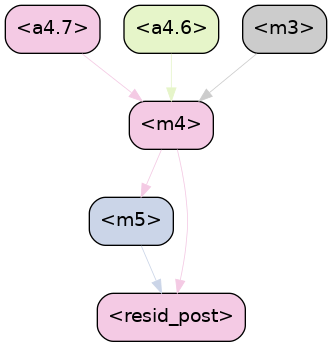

14 --------------------------------------------------
No edge 6
6
No edge 6
New metric: 0.49201855063438416
We moved to  None
No edge 6


/workspace/Automatic-Circuit-Discovery/acdc/TLACDCExperiment.py:772: UserWarning:

Finished iterating



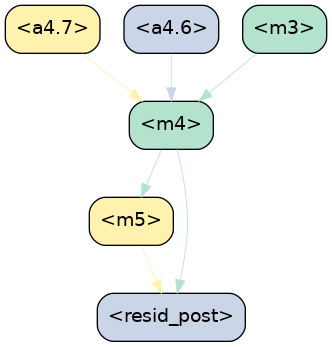

15 --------------------------------------------------
No edge 6
6


In [9]:
for i in range(args.max_num_epochs):
    exp.step(testing=False)

    show(
        exp.corr,
        f"ims/img_new_{i+1}.png",
        show_full_index=False,
    )

    if IN_COLAB or ipython is not None:
        # so long as we're not running this as a script, show the image!
        display(Image(f"ims/img_new_{i+1}.png"))

    print(i, "-" * 50)
    print(exp.count_no_edges())

    if i == 0:
        exp.save_edges("edges.pkl")

    if exp.current_node is None or SINGLE_STEP:
        break

exp.save_edges("another_final_edges.pkl")

if USING_WANDB:
    edges_fname = f"edges.pth"
    exp.save_edges(edges_fname)
    artifact = wandb.Artifact(edges_fname, type="dataset")
    artifact.add_file(edges_fname)
    wandb.log_artifact(artifact)
    os.remove(edges_fname)
    wandb.finish()

<h2>Save the final subgraph of the model</h2>
<p>There are more than `exp.count_no_edges()` here because we include some "placeholder" edges needed to make ACDC work that don't actually matter</p>
<p>Also note that the final image has more than 12 edges, because the edges from a0.0_q and a0.0_k are not connected to the input</p>
<p>We recover minimal induction machinery! `embed -> a0.0_v -> a1.6k`</p>

In [8]:
exp.save_subgraph(
    return_it=True,
)

OrderedDict([(('blocks.1.hook_resid_post',
               (None,),
               'blocks.1.attn.hook_result',
               (None, None, 6)),
              True),
             (('blocks.1.hook_resid_post',
               (None,),
               'blocks.0.hook_resid_pre',
               (None,)),
              True),
             (('blocks.1.attn.hook_result',
               (None, None, 6),
               'blocks.1.attn.hook_q',
               (None, None, 6)),
              True),
             (('blocks.1.attn.hook_result',
               (None, None, 6),
               'blocks.1.attn.hook_k',
               (None, None, 6)),
              True),
             (('blocks.1.attn.hook_result',
               (None, None, 6),
               'blocks.1.attn.hook_v',
               (None, None, 6)),
              True),
             (('blocks.1.attn.hook_q',
               (None, None, 6),
               'blocks.1.hook_q_input',
               (None, None, 6)),
              True),
        